# **Style Transfer Using GAN of MRI Images**




## **Importing Libraries**  

In [1]:
#Import all the required libraries

# Data Science 
import numpy as np, matplotlib, matplotlib.pyplot as plt

# Image Preprocess 
import skimage, imageio, PIL
from skimage.transform import resize
from PIL import Image

# OS Navigation 
import glob, os, pathlib, sys, time
from sys import platform

# Deep Learning 
import tensorflow as tf
# Importing tensorflow to build models
from tensorflow import keras
from tensorflow.keras import layers, Sequential
#Importing necessary library to import the images stored in local system
from tensorflow.keras.utils import image_dataset_from_directory
# Importing required libraries
from tensorflow.keras.utils import plot_model
from tensorflow.keras.layers import Dense, Dropout, BatchNormalization, Activation, Flatten, Conv2D, Conv2DTranspose
from keras.utils.vis_utils import plot_model

# Ignore Warnings 
import warnings
warnings.filterwarnings("ignore")

In [2]:
# Printing all the version of require libraries 
print("Numpy : {}" .format(np.__version__))
print("matplotlib : {}" .format(matplotlib.__version__))
print("tensorflow : {}" .format(tf.__version__))
print("skimage : {}" .format(skimage.__version__))
print("imageio : {}" .format(imageio.__version__))
print("PIL : {}" .format(PIL.__version__))
print("sys : {}" .format(sys.version))

Numpy : 1.24.4
matplotlib : 3.3.2
tensorflow : 2.9.1
skimage : 0.21.0
imageio : 2.35.1
PIL : 10.4.0
sys : 3.8.10 (default, Jan 17 2025, 14:40:23) 
[GCC 9.4.0]


## **Data Loading**

In [3]:
# setting path to the T1 an T2 datasets
T1_path = pathlib.Path('../data/raw/T1/')
T2_path = pathlib.Path('../data/raw/T2/')

## **Data Understanding:**     
The data from the Given data set (`MRI+T1_T2+Dataset.RAR`) containing both T1 and T2 MRI images in RGB format of base size (217 x 181). Given images should be preprocessed for further analysis. 

The T1 and T2 MRI Images included in the dataset are not related in any way since we have an unpaired dataset here. Hence we would be using cycleGAN in this problem

### **Basic EDA**        

In [4]:
# verifying the image count in the dataset
T1_image_count = len(list(T1_path.glob('*/*.png'))) # all the data inside the dataset are in PNG format
T2_image_count = len(list(T2_path.glob('*/*.png')))

print('Number of images in T1 directory --> ',T1_image_count)
print('Number of images in T2 directory --> ',T2_image_count)

Number of images in T1 directory -->  43
Number of images in T2 directory -->  46


### **Basic Data Visualization**

Found 43 files belonging to 1 classes.


2025-02-19 14:19:09.525134: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:961] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2025-02-19 14:19:09.570214: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:961] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2025-02-19 14:19:09.570756: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:961] could not open file to read NUMA node: /sys/bus/pci/devices/0000:01:00.0/numa_node
Your kernel may have been built without NUMA support.
2025-02-19 14:19:09.571924: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate

T1 data examples


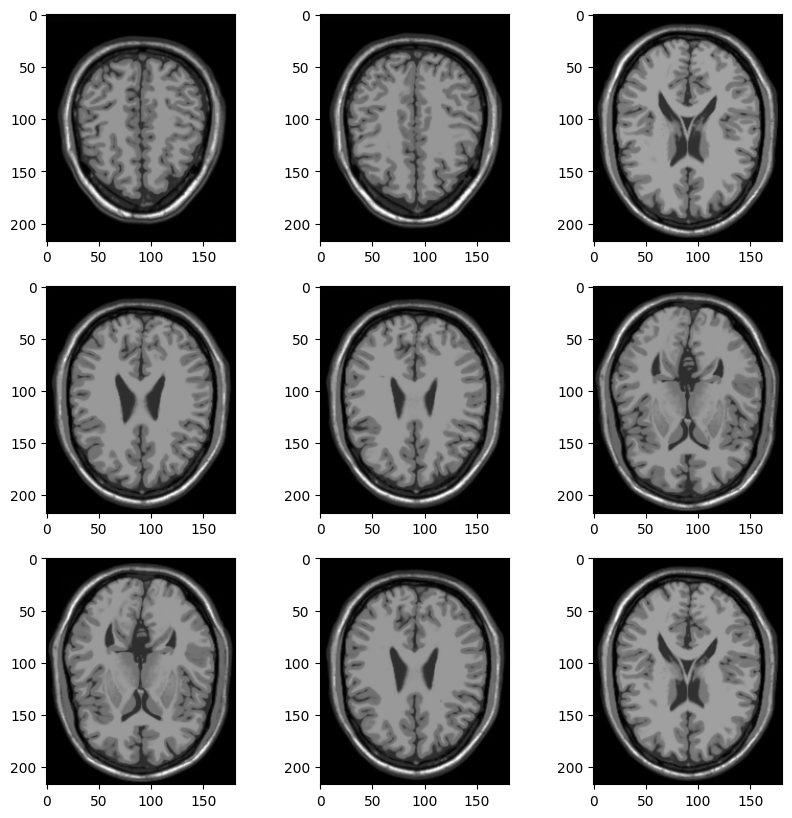

In [5]:
# Setting input image sizes 
IMG_HEIGHT = 217
IMG_WIDTH = 181

# Loading T1 images
images_T1 = image_dataset_from_directory(T1_path, seed = 123, shuffle = True, labels = None,
                                         image_size=(IMG_HEIGHT, IMG_WIDTH), batch_size=64)
# Visualizing data from T1 dataset
plt.figure(figsize=(10, 10))
for images in images_T1.take(1):
    print("T1 data examples")
    for i in range(9):
        ax = plt.subplot(3, 3, i + 1)
        plt.imshow(images[i].numpy().astype("uint8"))

Found 46 files belonging to 1 classes.
T2 data examples



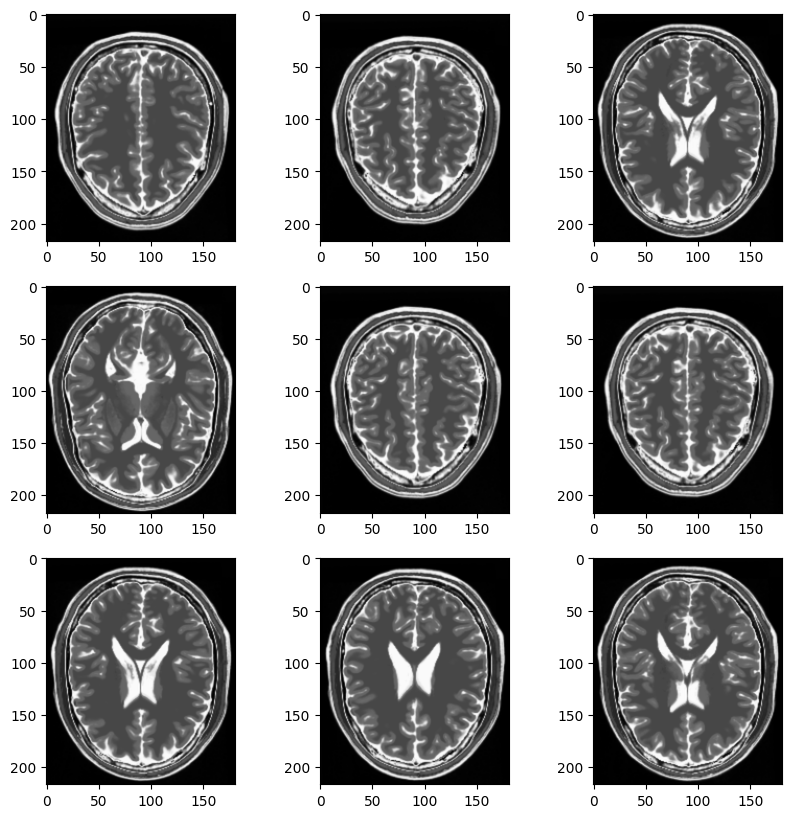

In [6]:
# Loading T2 images
images_T2 = image_dataset_from_directory(T2_path, seed = 123, shuffle = True, labels = None,
                                         image_size=(IMG_HEIGHT, IMG_WIDTH), batch_size=64)
# Visualizing data from T2 dataset
plt.figure(figsize=(10, 10))
for images in images_T2.take(1):
    print("T2 data examples\n")
    for i in range(9):
        ax = plt.subplot(3, 3, i + 1)
        plt.imshow(images[i].numpy().astype("uint8"))

In [7]:
# Checking range of values of the pixels making up the image in T1 data
image_batch = next(iter(images_T1))
first_image = image_batch[0]
print("T1 data pixel value range: ", np.min(first_image), np.max(first_image))

T1 data pixel value range:  0.0 255.0


In [8]:
# Checking range of values of the pixels making up the image in T2 data
image_batch = next(iter(images_T2))
first_image = image_batch[0]
print("T2 data pixel value range: ", np.min(first_image), np.max(first_image))

T2 data pixel value range:  0.0 255.0


## **Data Preprocessing**

### **Data Resizing, Reshaping, Shuffling and Batch Data**

In [9]:
# method to load the images from the given directory path
def data_load(directory):
    image = tf.keras.preprocessing.image_dataset_from_directory(directory,
                                                                labels='inferred', 
                                                                label_mode='int', 
                                                                class_names=None, 
                                                                color_mode='grayscale', 
                                                                batch_size=1, 
                                                                image_size=(256, 256), 
                                                                shuffle= True, 
                                                                seed=42, 
                                                                validation_split=None, 
                                                                subset=None, 
                                                                interpolation='bilinear', 
                                                                follow_links=False)
    return image

### **Data Normalization**

In [10]:
# method to normalize single channel image (preprocessing-2)
def normalize(image, label):
    image = tf.cast(image, tf.float32)
    image = (image/ 127.5) - 1.0
    return image

### **Final Preposcessing**

In [11]:
# performing image load from directory, reshape, shuffle, batch and convert to grayscale (preprocessing-1)
def preprocess_data(directory):
    T = data_load(directory)
    T = T.map(normalize)

    return T

In [12]:
# preprocessing the data under T1 and T2
T1 = preprocess_data(T1_path)
T2 = preprocess_data(T2_path)

Found 43 files belonging to 1 classes.
Found 46 files belonging to 1 classes.


In [13]:
# iterating through all the preprocessed images and caching them
sample_T1 = next(iter(T1))
sample_T2 = next(iter(T2))

In [14]:
print("Shape of individual Sample T1 image: ",sample_T1[0].shape,"\n")
print("Shape of individual Sample T2 image: ",sample_T2[0].shape)

Shape of individual Sample T1 image:  (256, 256, 1) 

Shape of individual Sample T2 image:  (256, 256, 1)


### **Visualization of Preprocessed Images**  

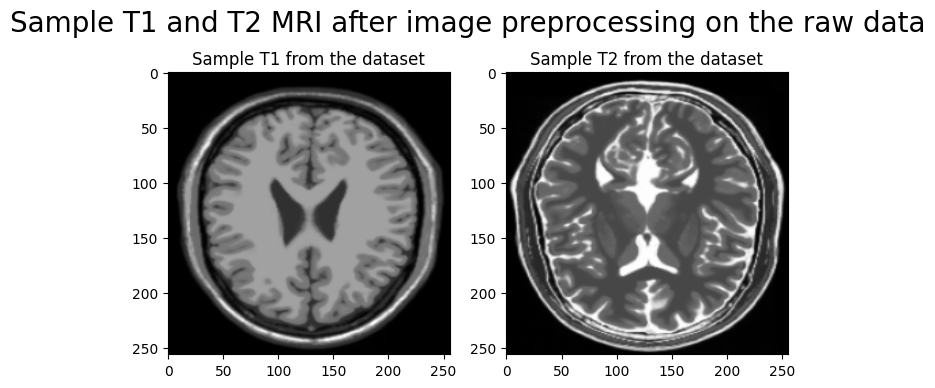

In [15]:
# visualizing preprocessed T1 and T2 from the input dataset
f, ax = plt.subplots(1,2, figsize=(8,8))
f.suptitle('Sample T1 and T2 MRI after image preprocessing on the raw data', fontsize=20, y=0.75)
ax[0].set_title('Sample T1 from the dataset')
ax[0].imshow(sample_T1[0].numpy()[:, :, 0], cmap = 'gray')
ax[1].set_title('Sample T2 from the dataset')
ax[1].imshow(sample_T2[0].numpy()[:, :, 0], cmap = 'gray')
plt.show()

## **Model Building**

### **Instance Normalization**

In [16]:
class InstanceNormalization(tf.keras.layers.Layer):
    # Initialization of Objects
    def __init__(self, epsilon=1e-5, **kwargs):
        # calling parent's init
        super(InstanceNormalization, self).__init__(**kwargs)
        self.epsilon = epsilon
    
    def build(self, input_shape):
        self.scale = self.add_weight(
            name='scale',
            shape=input_shape[-1:],
            initializer=tf.random_normal_initializer(1., 0.02),
            trainable=True)
        self.offset = self.add_weight(
            name='offset',
            shape=input_shape[-1:],
            initializer='zeros',
            trainable=True)
    
    def call(self, x):
        # Compute Mean and Variance, Axes=[1,2] ensures Instance Normalization
        mean, variance = tf.nn.moments(x, axes=[1, 2], keepdims=True)
        inv = tf.math.rsqrt(variance + self.epsilon)
        normalized = (x - mean) * inv
        return self.scale * normalized + self.offset

    def get_config(self):
        config = super().get_config()
        config.update({
            "epsilon": self.epsilon
        })
        return config

### **Generator: U-net architecture**

In [17]:
# method to downsample images using convolution, downsamples the image dimensions
def downsample(filters, size, apply_norm=True):
    initializer = tf.random_normal_initializer(0., 0.02)
    result = tf.keras.Sequential()
    # Add Conv2d layer
    result.add(tf.keras.layers.Conv2D(filters, size, strides=2, padding='same',
                                      kernel_initializer=initializer, use_bias=False))
    # Add Normalization layer
    if apply_norm:
        result.add(InstanceNormalization())
    # Add Parametric Relu Activation
    result.add(tf.keras.layers.PReLU())
    return result

In [18]:
# method to upsample the downsampled images connected to a transformer block, upsamples the image dimension
def upsample(filters, size, apply_dropout=False):
    initializer = tf.random_normal_initializer(0., 0.02)
    result = tf.keras.Sequential()
    # Add Transposed Conv2d layer
    result.add(tf.keras.layers.Conv2DTranspose(filters, size, strides=2, padding='same',
                                               kernel_initializer=initializer, use_bias=False))
    # Add Normalization Layer
    result.add(InstanceNormalization())
    # Conditionally add Dropout layer
    if apply_dropout:
        result.add(tf.keras.layers.Dropout(0.5))
    # Add Relu Activation Layer
    result.add(tf.keras.layers.ReLU())
    return result

In [19]:
# Building U-net generator which is a combination of Convolution + Transposed Convolution Layers
def unet_generator():
    # initialinzing input
    inputs = tf.keras.layers.Input(shape=[256,256,1]) 
    # defining downsampling layers
    # increasing the image size from (256 x 256 x 1) --> (1 x 1 x 512)
    down_stack = [
        downsample(128, 4, apply_norm=False), 
        downsample(256, 4), 
        downsample(512, 4), 
        downsample(512, 4), 
        downsample(512, 4), 
        downsample(512, 4), 
        downsample(512, 4), 
        downsample(512, 4), 
    ]
    # defining upsamplinglayers
    # decreasing the image size from (1 x 1 x 512) --> (128 x 128 x 256)
    up_stack = [
        upsample(512, 4, apply_dropout=True),
        upsample(512, 4, apply_dropout=True), 
        upsample(512, 4, apply_dropout=True), 
        upsample(512, 4), 
        upsample(512, 4), 
        upsample(256, 4), 
        upsample(128, 4),
    ]
    # initializing last layer
    # (125 x 128 x 256) --> (256 x 256 x 1)
    initializer = tf.random_normal_initializer(0., 0.02)
    last = tf.keras.layers.Conv2DTranspose(1, 4,
                                            strides=2,
                                            padding='same',
                                            kernel_initializer=initializer,
                                            activation='tanh') 

    # Defining model layers
    x = inputs # input layer
    # skip connections is used to concatenate encoder with decoder
    skips = []
    # downsampling layers
    for down in down_stack:
        x = down(x)
        skips.append(x)
    skips = reversed(skips[:-1])
    # Upsampling layers and establishing the skip connections
    for up, skip in zip(up_stack, skips):
        x = up(x)
        x = tf.keras.layers.Concatenate()([x, skip])
    x = last(x)
    
    return tf.keras.Model(inputs=inputs, outputs=x) # returns U-net generator model

In [20]:
# initializing the generator
generator_g = unet_generator() # T1 images will transform to T2
generator_f = unet_generator() # T2 images will transform to T1

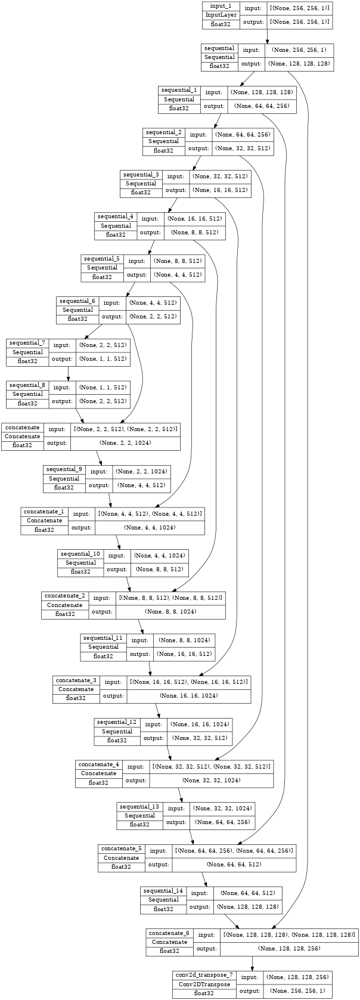

In [21]:
# visualizing the U-net model(generator) using plot_model
# explains the transformations iccured in U-net generator
tf.keras.utils.plot_model(
    generator_g,
    to_file="../reports/figures/unet_generator_model.png",
    show_shapes=True,
    show_dtype=True,
    show_layer_names=True,
    rankdir="TB",
    expand_nested=False,
    dpi=48)

In [22]:
# summarizing U-net Generator
generator_g.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 256, 256, 1  0           []                               
                                )]                                                                
                                                                                                  
 sequential (Sequential)        (None, 128, 128, 12  2099200     ['input_1[0][0]']                
                                8)                                                                
                                                                                                  
 sequential_1 (Sequential)      (None, 64, 64, 256)  1573376     ['sequential[0][0]']             
                                                                                              

### **Discriminator: CNN architechture**

In [23]:
# Building the discriminator
# Discriminators only contain Convolutional layers and no Transposed Convolution is used.
def discriminator():
  initializer = tf.random_normal_initializer(0., 0.02)
  # add input layer of size (256,256,1)
  inputs = tf.keras.layers.Input(shape=[256,256, 1], name='input_image')
  x = inputs

  # add downsampling step here
  down1 = downsample(128, 4, False)(x) 
  down2 = downsample(256, 4)(down1) 
  down3 = downsample(512, 4)(down2) 
  
  # add a padding layer here
  zero_pad1 = tf.keras.layers.ZeroPadding2D()(down3) 
  conv = tf.keras.layers.Conv2D(512, 4, strides=1, kernel_initializer=initializer,
                                use_bias=False)(zero_pad1) 
  norm1 = InstanceNormalization()(conv)
  leaky_relu = tf.keras.layers.PReLU()(norm1)

  # apply zero padding layer
  zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu) 
  last = tf.keras.layers.Conv2D(1, 4, strides=1, kernel_initializer=initializer)(zero_pad2) 
  return tf.keras.Model(inputs=[inputs], outputs=last) 

In [24]:
# Initializing the discriminators
discriminator_x = discriminator() # separates real T1 from generated T1
discriminator_y = discriminator() # separates real T2 from generated T2

In [25]:
# summarizing the discriminator
discriminator_x.summary()

Model: "model_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_image (InputLayer)    [(None, 256, 256, 1)]     0         
                                                                 
 sequential_30 (Sequential)  (None, 128, 128, 128)     2099200   
                                                                 
 sequential_31 (Sequential)  (None, 64, 64, 256)       1573376   
                                                                 
 sequential_32 (Sequential)  (None, 32, 32, 512)       2622464   
                                                                 
 zero_padding2d (ZeroPadding  (None, 34, 34, 512)      0         
 2D)                                                             
                                                                 
 conv2d_19 (Conv2D)          (None, 31, 31, 512)       4194304   
                                                           

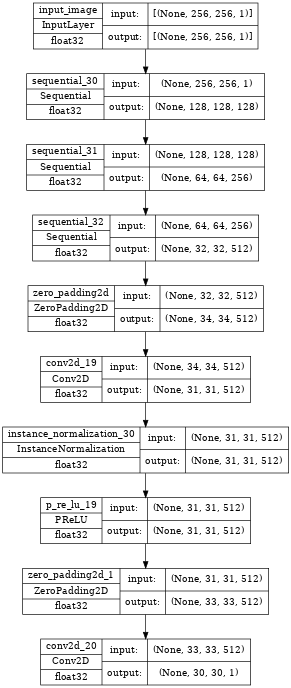

In [26]:
# visualising the created Discriminator model using plot_model
tf.keras.utils.plot_model(
    discriminator_x,
    to_file="../reports/figures/discriminator_model.png",
    show_shapes=True,
    show_dtype=True,
    show_layer_names=True,
    rankdir="TB",
    expand_nested=False,
    dpi=48)

## **Model Training**

2025-02-19 14:19:20.566255: I tensorflow/stream_executor/cuda/cuda_dnn.cc:384] Loaded cuDNN version 8201
2025-02-19 14:19:23.845162: W tensorflow/stream_executor/gpu/asm_compiler.cc:230] Falling back to the CUDA driver for PTX compilation; ptxas does not support CC 8.9
2025-02-19 14:19:23.845260: W tensorflow/stream_executor/gpu/asm_compiler.cc:233] Used ptxas at ptxas
2025-02-19 14:19:23.845372: W tensorflow/stream_executor/gpu/redzone_allocator.cc:314] UNIMPLEMENTED: ptxas ptxas too old. Falling back to the driver to compile.
Relying on driver to perform ptx compilation. 
Modify $PATH to customize ptxas location.
This message will be only logged once.


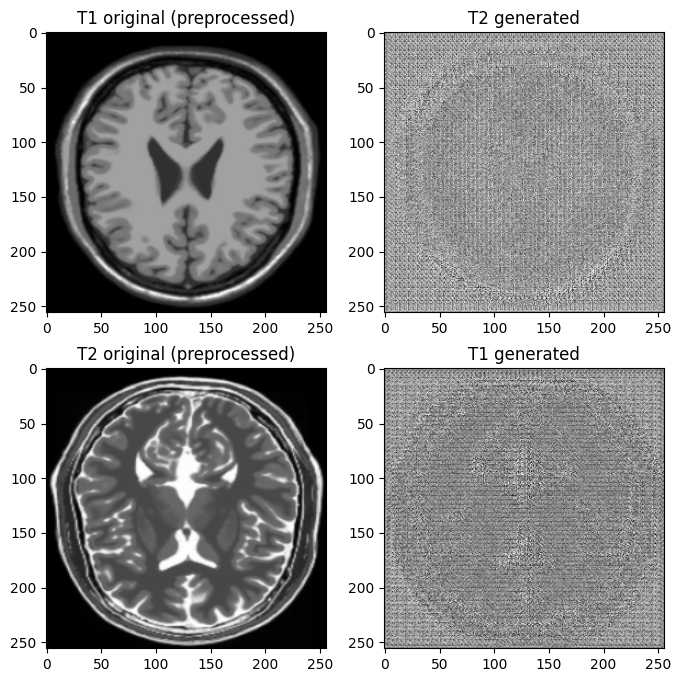

In [27]:
# plotting the original and generated images using created Generator to check its working

fake_T2 = generator_g(sample_T1)
fake_T1 = generator_f(sample_T2)
img_array = [sample_T1, fake_T2, sample_T2, fake_T1]
img_title = ['T1 original (preprocessed)', 'T2 generated', 'T2 original (preprocessed)', 'T1 generated']

f, ax = plt.subplots(2, 2, figsize=(8,8))
ax[0,0].set_title(img_title[0])
ax[0,0].imshow(img_array[0][0].numpy()[:, :, 0], cmap='gray')
ax[0,1].set_title(img_title[1])
ax[0,1].imshow(img_array[1][0].numpy()[:, :, 0], cmap='gray')
ax[1,0].set_title(img_title[2])
ax[1,0].imshow(img_array[2][0].numpy()[:, :, 0], cmap='gray')
ax[1,1].set_title(img_title[3])
ax[1,1].imshow(img_array[3][0].numpy()[:, :, 0], cmap='gray')
plt.show()

In [28]:
# Declare Loss as Binary Cross Entropy
loss_fn = tf.keras.losses.BinaryCrossentropy(from_logits=True)

In [29]:
# Discriminator adversarial loss

def discriminator_loss(real, generated):
  real_loss = loss_fn(tf.ones_like(real), real)
  generated_loss = loss_fn(tf.zeros_like(generated), generated)
  total_disc_loss = real_loss + generated_loss
  return total_disc_loss * 0.5   # mean of losses

In [30]:
# Generator loss
def generator_loss(generated):
  return loss_fn(tf.ones_like(generated), generated)

In [31]:
LAMBDA = 10 # learning rate

# method to calculate cycle consitency loss
def cycle_consistency_loss(real_image, cycled_image):
  cyc_loss = tf.reduce_mean(tf.abs(real_image - cycled_image))  # Averages out all values in the input
  return LAMBDA * cyc_loss # Weight of 10 used as contribution of cycle loss to total loss. This is a hyperparameter.

In [32]:
# method to calculate identity loss
def identity_loss(real_image, same_image):
  loss = tf.reduce_mean(tf.abs(real_image - same_image)) # Averages out all values in the input
  return LAMBDA * 0.5 * loss

In [33]:
# defining optimizer: Adam Optimizer
generator_g_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
generator_f_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

discriminator_x_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_y_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

In [34]:
# number of epochs for the model to be trained
EPOCHS = 100

In [35]:
# Directory to keep Checkpoints at each epoch
if not os.path.isdir('../models/training_checkpoints'):
    os.mkdir('../models/training_checkpoints')

checkpoint_path = "../models/training_checkpoints"

checkpoint = tf.train.Checkpoint(generator_g=generator_g,
                           generator_f=generator_f,
                           discriminator_x=discriminator_x,
                           discriminator_y=discriminator_y,
                           generator_g_optimizer=generator_g_optimizer,
                           generator_f_optimizer=generator_f_optimizer,
                           discriminator_x_optimizer=discriminator_x_optimizer,
                           discriminator_y_optimizer=discriminator_y_optimizer)

checkpoint_manager = tf.train.CheckpointManager(checkpoint, checkpoint_path, max_to_keep=EPOCHS)

# if a checkpoint exists, restore the latest checkpoint.
if checkpoint_manager.latest_checkpoint:
  checkpoint.restore(checkpoint_manager.latest_checkpoint)
  print('Latest checkpoint restored!!')

Latest checkpoint restored!!


In [36]:
# Function to show Images output by Generators while Training
def generate_images(model1, test_input1, model2, test_input2):
    prediction1 = model1(test_input1) # Image Translation from T1 to T2
    prediction2 = model2(test_input2) # Image Translation from T2 to T1
    plt.figure(figsize=(12, 8))
    display_list = [test_input1[0], prediction1[0], test_input2[0], prediction2[0]]
    title = ['Input T1', 'Predicted T2 - Epoch ' + str(epoch+1), 'Input T2', 'Predicted T1 - Epoch ' + str(epoch+1)]
    for i in range(4):
        plt.subplot(1, 4, i+1)
        plt.title(title[i])
        plt.imshow(display_list[i].numpy()[:, :, 0], cmap='gray')
        plt.axis('off')
    plt.savefig('../reports/chkpt_images/image_at_epoch_{:04d}.png'.format(epoch+1))
    plt.show()

## **Training Flow**    

In [37]:
# training step function
@tf.function 
def train_step(real_x, real_y):
  # persistent is set to True because the tape is used more than once to calculate the gradients.
  with tf.GradientTape(persistent=True) as tape:
    # Generator G translates X -> Y
    # Generator F translates Y -> X.
    fake_y = generator_g(real_x, training=True) # synthetic T2 from input T1
    cycled_x = generator_f(fake_y, training=True) # T1 from synthetic T2

    fake_x = generator_f(real_y, training=True) # synthetic T1 from input T2
    cycled_y = generator_g(fake_x, training=True) # T2 from synthetic T1

    # same_x and same_y are used for identity loss.
    same_x = generator_f(real_x, training=True) # same T1 from input T1
    same_y = generator_g(real_y, training=True) # same T2 from input T2

    disc_real_x = discriminator_x(real_x, training=True) # patch from T1 input
    disc_real_y = discriminator_y(real_y, training=True) # patch from T2 input

    disc_fake_x = discriminator_x(fake_x, training=True) # patch from T1 synthetic
    disc_fake_y = discriminator_y(fake_y, training=True) # patch from T2 synthetic

    # generator loss
    gen_g_loss = generator_loss(disc_fake_y) # loss from T2 synthetic image
    gen_f_loss = generator_loss(disc_fake_x) # loss from T1 synthetic image

    # Calculate cycle loss
    total_cycle_loss = cycle_consistency_loss(real_x, cycled_x) + cycle_consistency_loss(real_y, cycled_y)

    # Total generator loss = BCE loss + cycle loss + identity loss
    total_gen_g_loss = gen_g_loss + total_cycle_loss + identity_loss(real_y, same_y)
    total_gen_f_loss = gen_f_loss + total_cycle_loss + identity_loss(real_x, same_x)

    # Discriminator's loss
    disc_x_loss = discriminator_loss(disc_real_x, disc_fake_x)
    disc_y_loss = discriminator_loss(disc_real_y, disc_fake_y)
    
  # Calculate the gradients for generator and discriminator
  generator_g_gradients = tape.gradient(total_gen_g_loss, generator_g.trainable_variables)
  generator_f_gradients = tape.gradient(total_gen_f_loss, generator_f.trainable_variables)
  
  discriminator_x_gradients = tape.gradient(disc_x_loss, discriminator_x.trainable_variables) 
  discriminator_y_gradients = tape.gradient(disc_y_loss, discriminator_y.trainable_variables) 
  
  # Apply the gradients to the optimizer
  generator_g_optimizer.apply_gradients(zip(generator_g_gradients,generator_g.trainable_variables))
  generator_f_optimizer.apply_gradients(zip(generator_f_gradients,generator_f.trainable_variables))

  discriminator_x_optimizer.apply_gradients(zip(discriminator_x_gradients,discriminator_x.trainable_variables))
  discriminator_y_optimizer.apply_gradients(zip(discriminator_y_gradients,discriminator_y.trainable_variables))

In [38]:
# method to save finalized model trained and evaluated for further use
def final_model_save(epoch, generator_g, generator_f):
    model_save_path = '../models/model_save/'
    T1_to_T2_model = model_save_path + 'T1_to_T2_final_model.h5'
    generator_g.save(T1_to_T2_model)
    T2_to_T1_model = model_save_path + 'T2_to_T1_final_model.h5'
    generator_f.save(T2_to_T1_model)
    print('trained models saved at %06d' % (epoch+1))

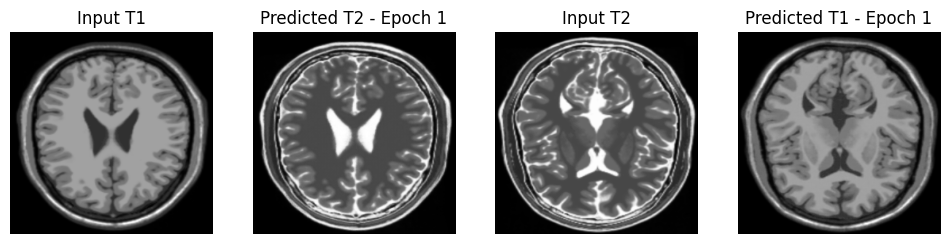

Time taken in 83 seconds for epoch 1



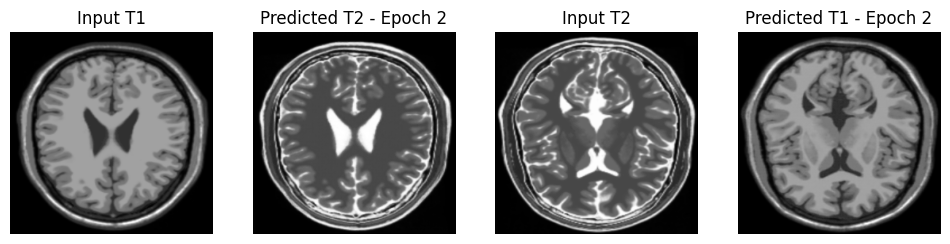

Time taken in 22 seconds for epoch 2



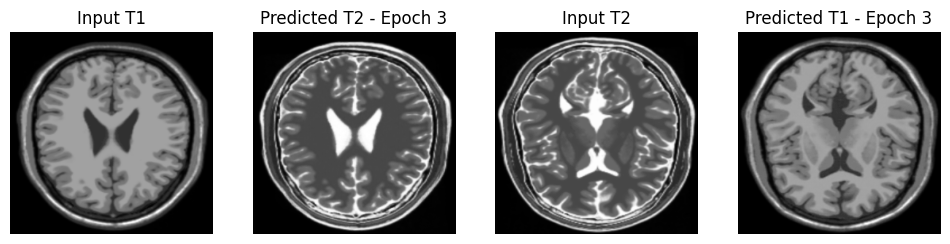

Time taken in 22 seconds for epoch 3



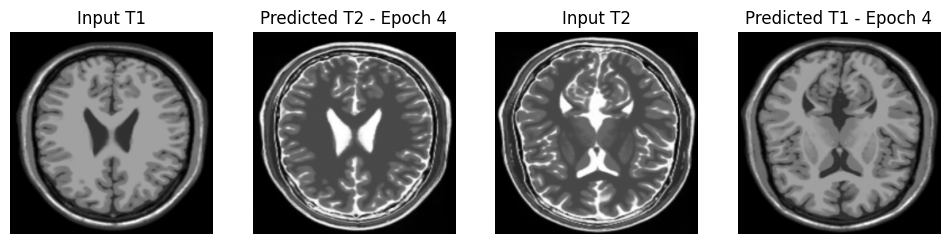

Time taken in 42 seconds for epoch 4



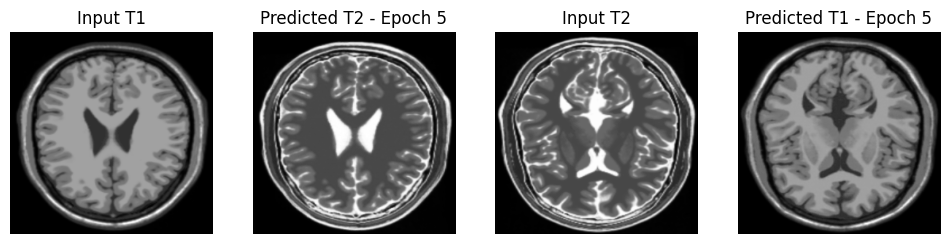

Time taken in 22 seconds for epoch 5



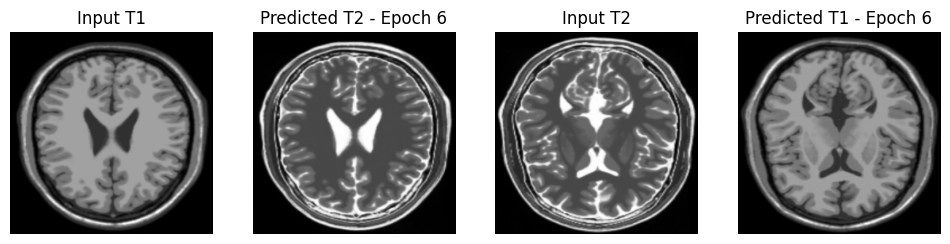

Time taken in 22 seconds for epoch 6



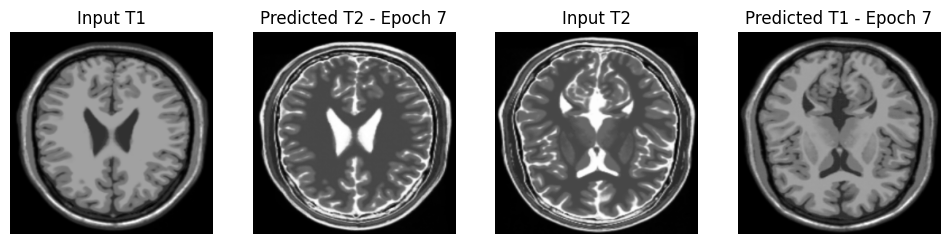

Time taken in 42 seconds for epoch 7



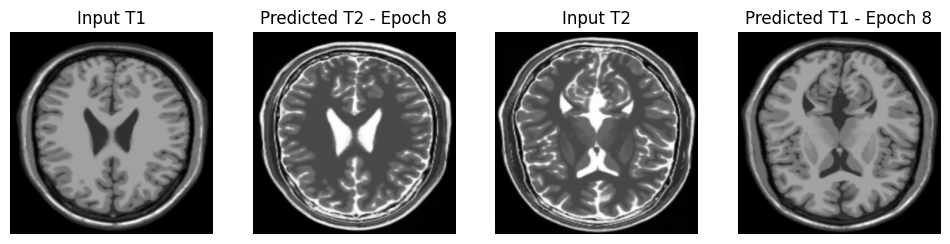

Time taken in 22 seconds for epoch 8



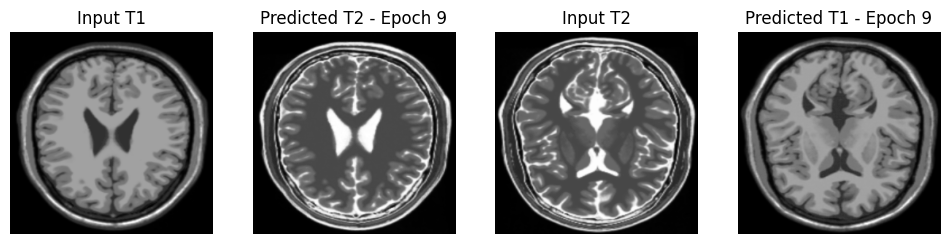

Time taken in 22 seconds for epoch 9



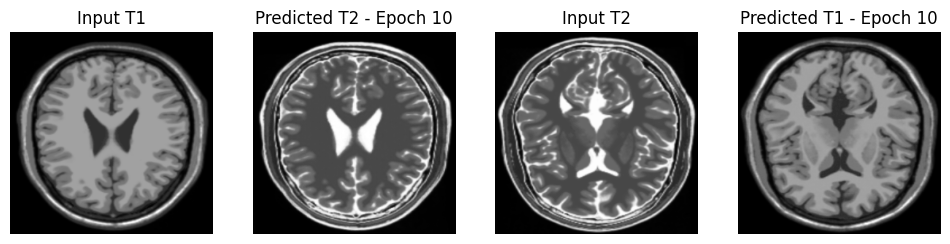

Checkpoint restored for epoch 10 at ../models/training_checkpoints/ckpt-11
Time taken in 31 seconds for epoch 10



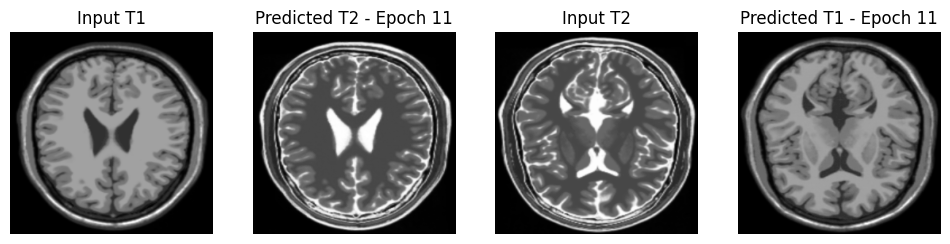

Time taken in 23 seconds for epoch 11



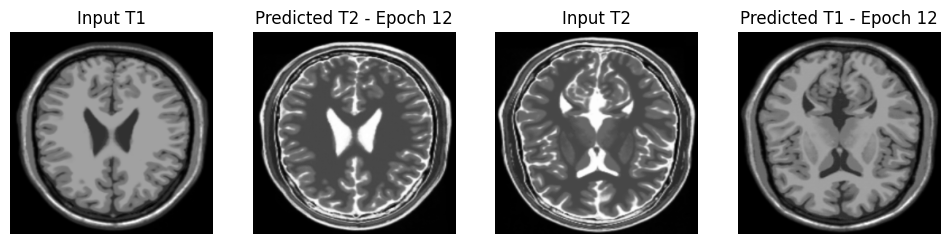

Time taken in 22 seconds for epoch 12



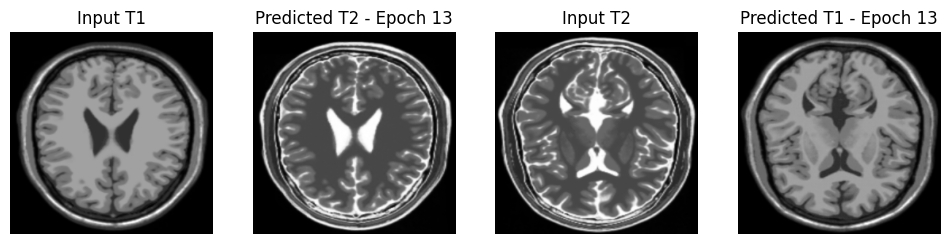

Time taken in 23 seconds for epoch 13



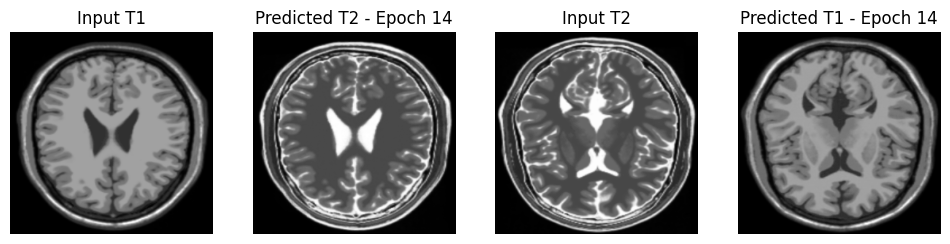

Time taken in 22 seconds for epoch 14



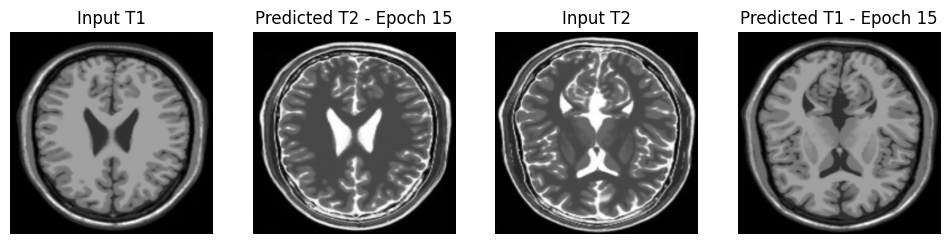

Time taken in 22 seconds for epoch 15



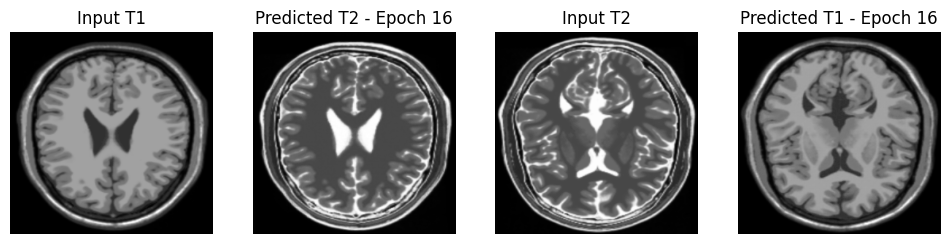

Time taken in 23 seconds for epoch 16



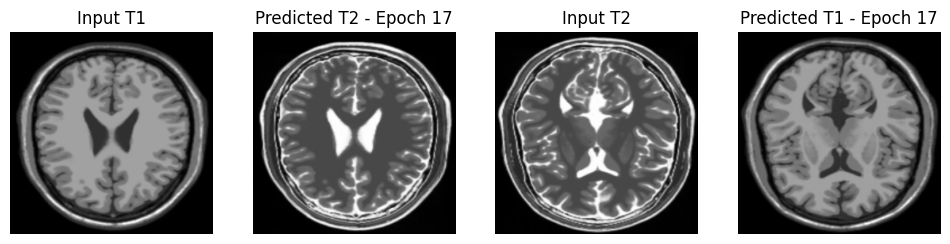

Time taken in 22 seconds for epoch 17



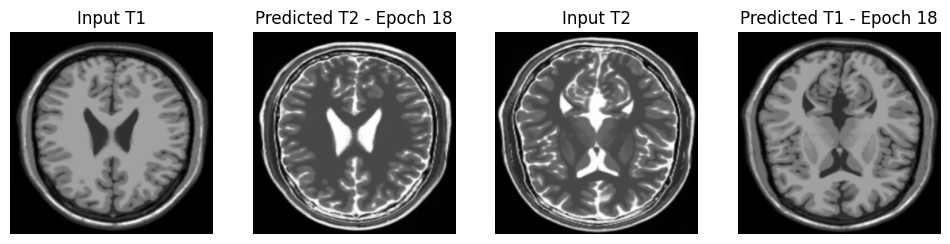

Time taken in 22 seconds for epoch 18



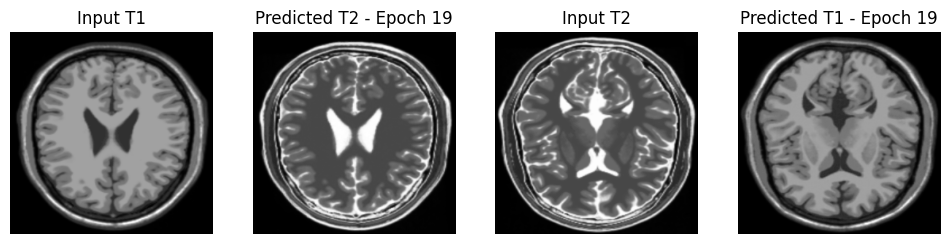

Time taken in 42 seconds for epoch 19



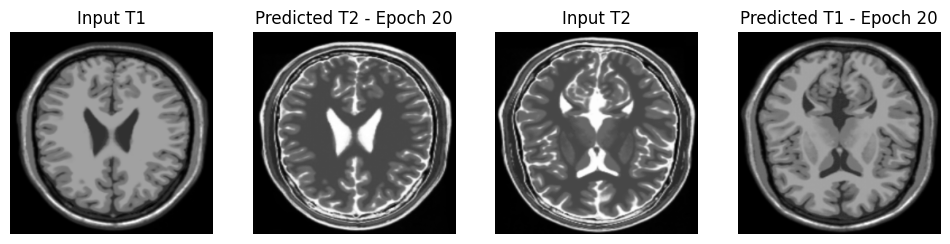

Checkpoint restored for epoch 20 at ../models/training_checkpoints/ckpt-12
Time taken in 30 seconds for epoch 20



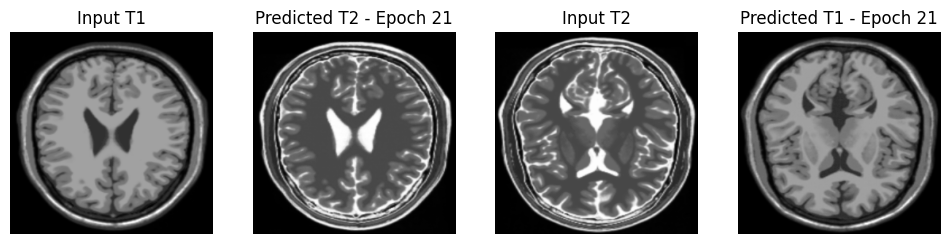

Time taken in 22 seconds for epoch 21



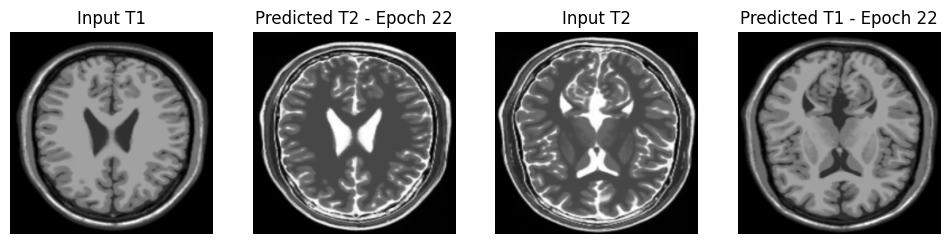

Time taken in 22 seconds for epoch 22



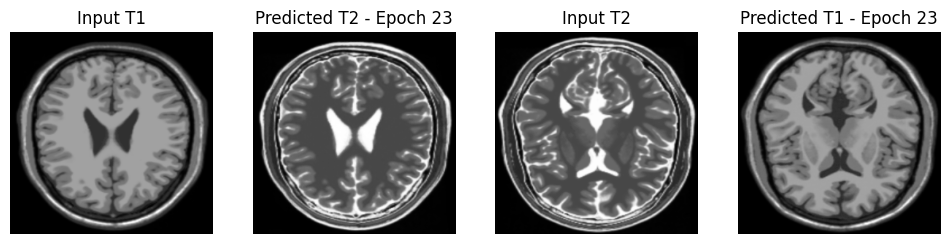

Time taken in 22 seconds for epoch 23



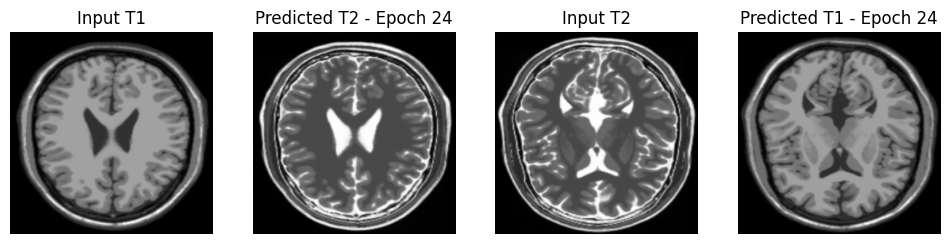

Time taken in 22 seconds for epoch 24



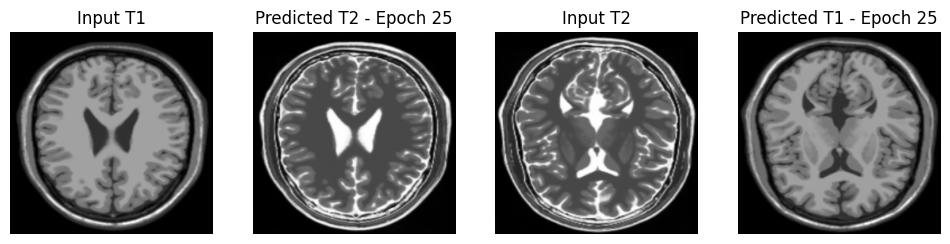

Time taken in 23 seconds for epoch 25



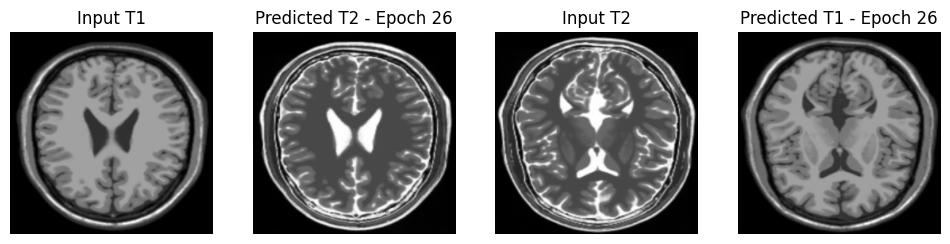

Time taken in 23 seconds for epoch 26



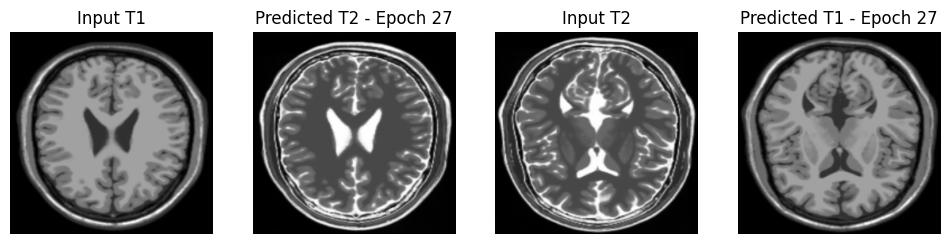

Time taken in 22 seconds for epoch 27



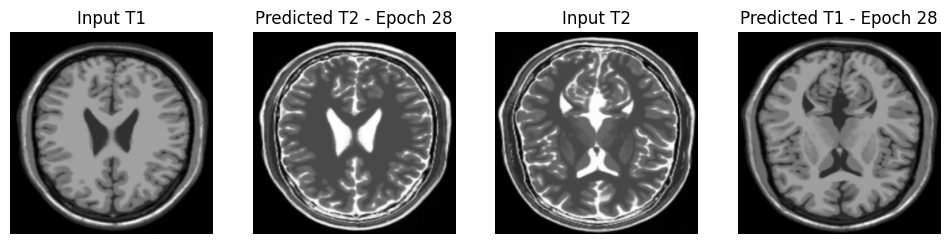

Time taken in 22 seconds for epoch 28



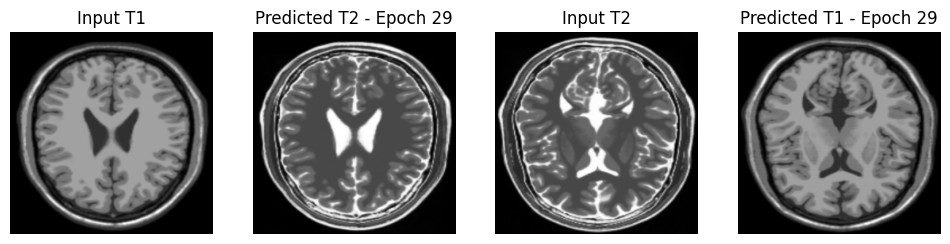

Time taken in 23 seconds for epoch 29



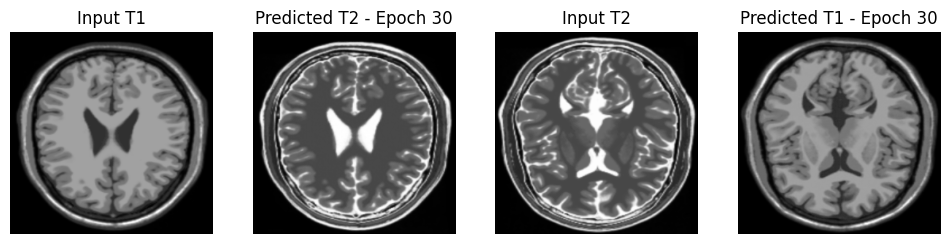

Checkpoint restored for epoch 30 at ../models/training_checkpoints/ckpt-13
Time taken in 29 seconds for epoch 30



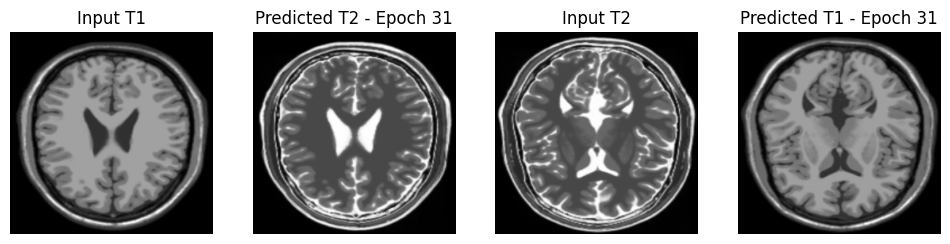

Time taken in 23 seconds for epoch 31



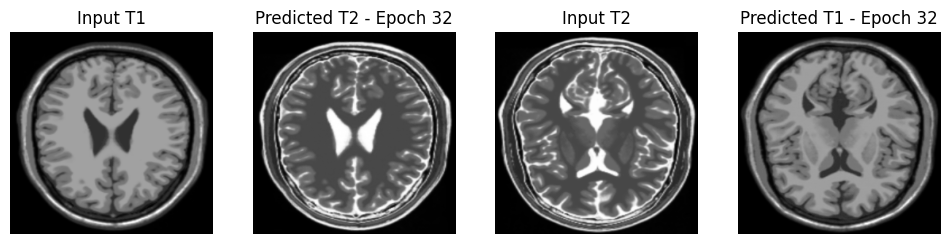

Time taken in 22 seconds for epoch 32



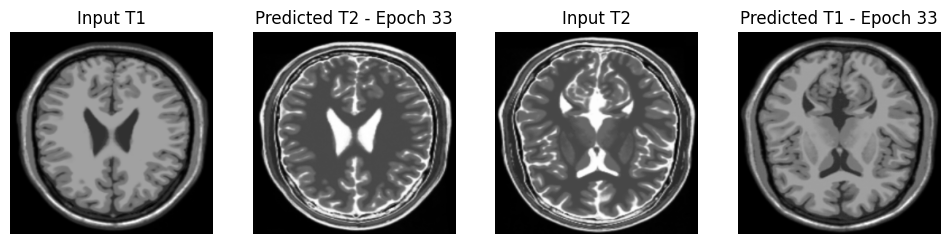

Time taken in 22 seconds for epoch 33



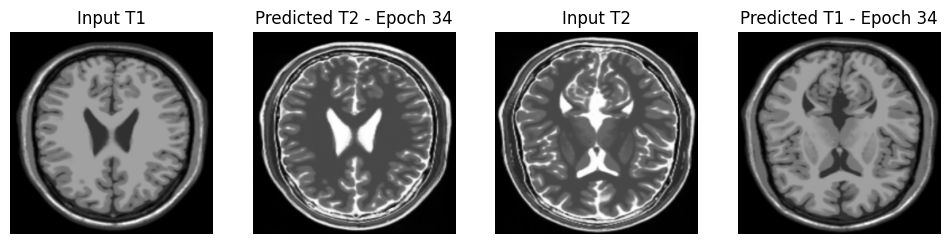

Time taken in 23 seconds for epoch 34



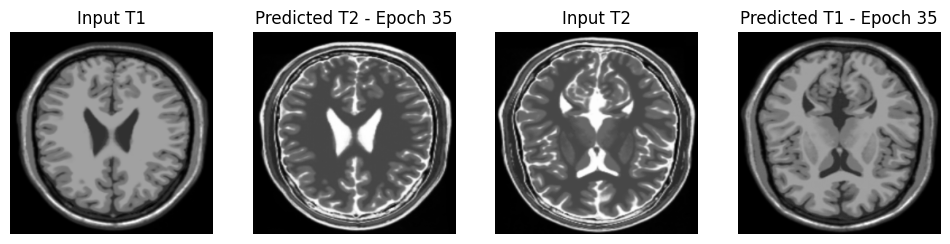

Time taken in 24 seconds for epoch 35



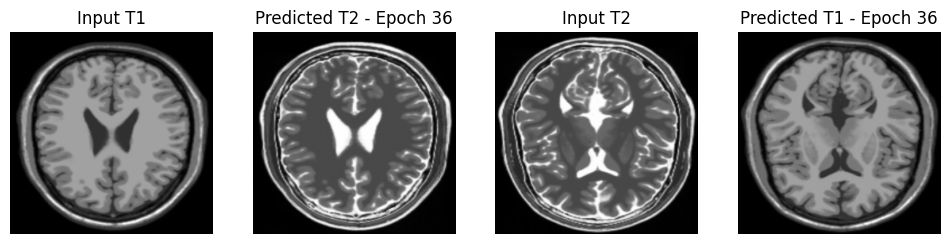

Time taken in 23 seconds for epoch 36



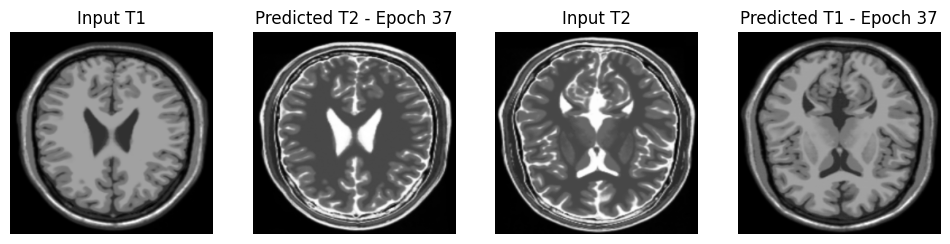

Time taken in 23 seconds for epoch 37



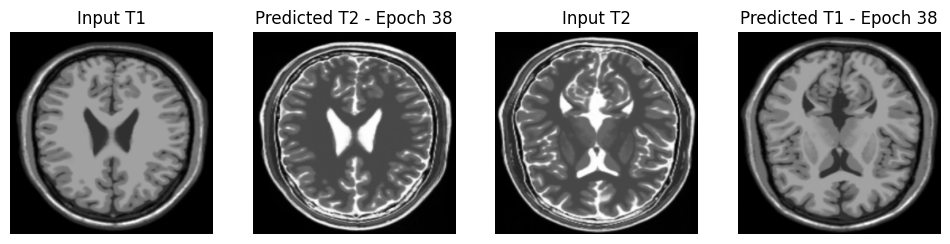

Time taken in 23 seconds for epoch 38



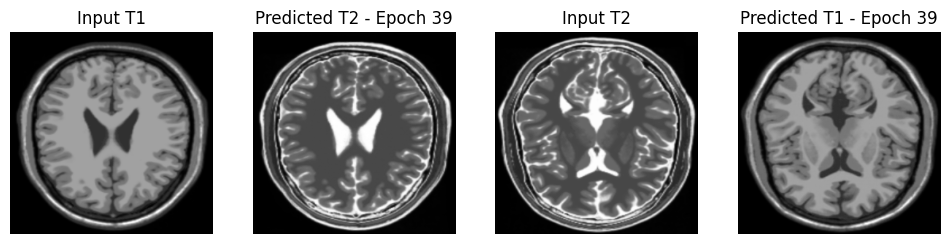

Time taken in 21 seconds for epoch 39



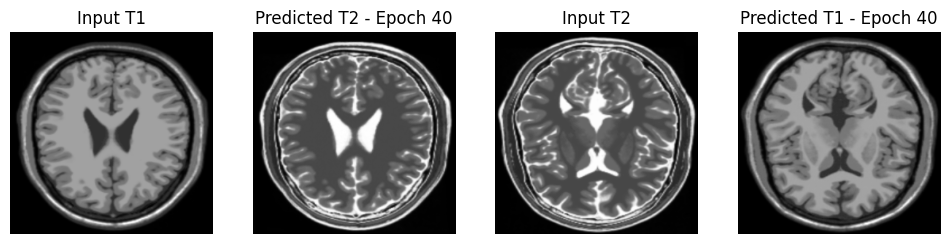

Checkpoint restored for epoch 40 at ../models/training_checkpoints/ckpt-14
Time taken in 27 seconds for epoch 40



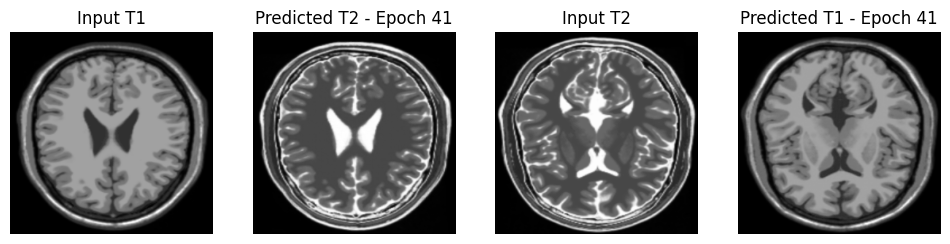

Time taken in 23 seconds for epoch 41



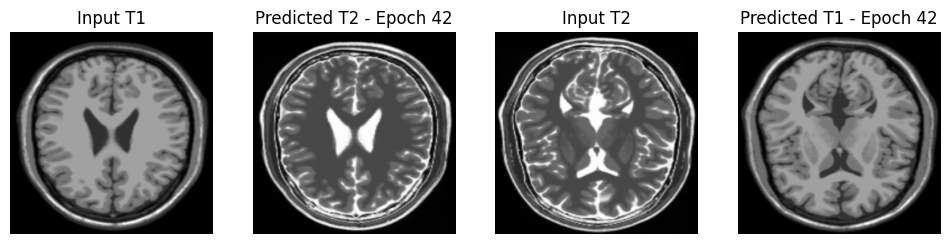

Time taken in 22 seconds for epoch 42



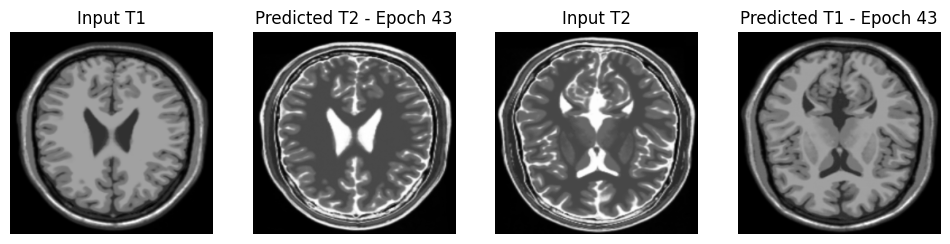

Time taken in 22 seconds for epoch 43



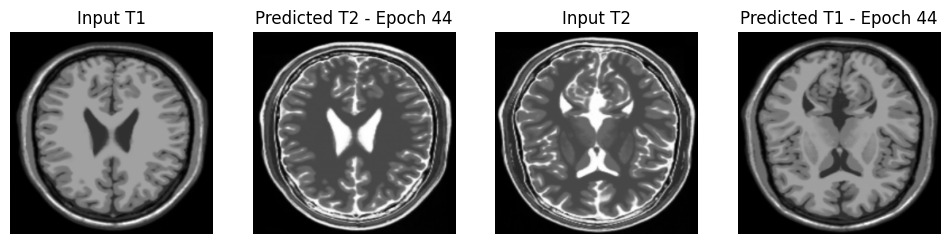

Time taken in 22 seconds for epoch 44



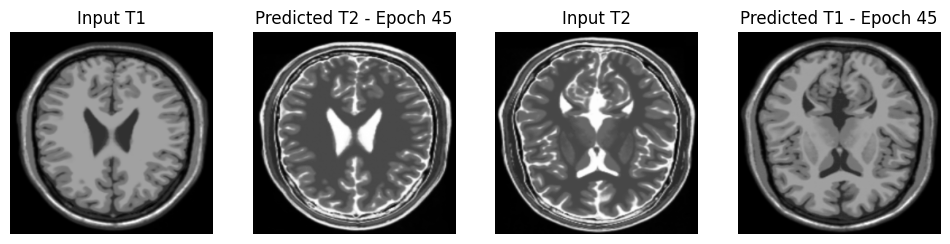

Time taken in 22 seconds for epoch 45



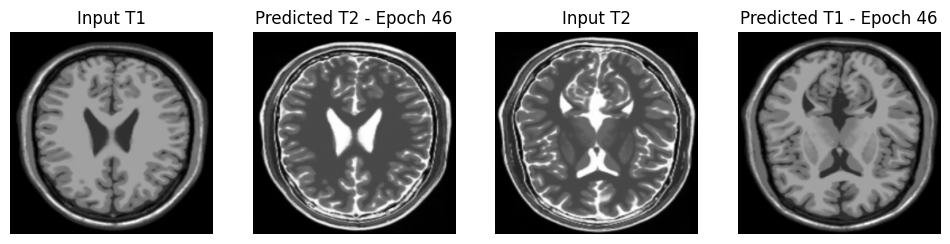

Time taken in 22 seconds for epoch 46



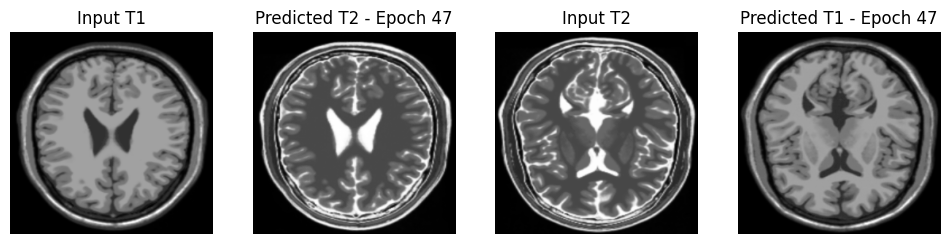

Time taken in 23 seconds for epoch 47



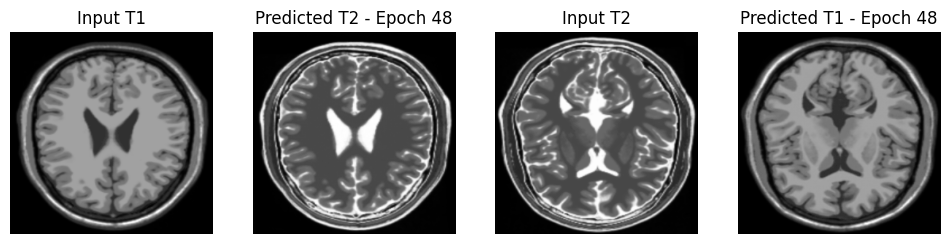

Time taken in 22 seconds for epoch 48



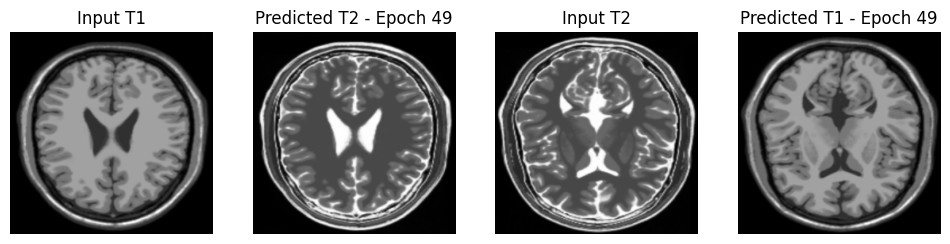

Time taken in 22 seconds for epoch 49



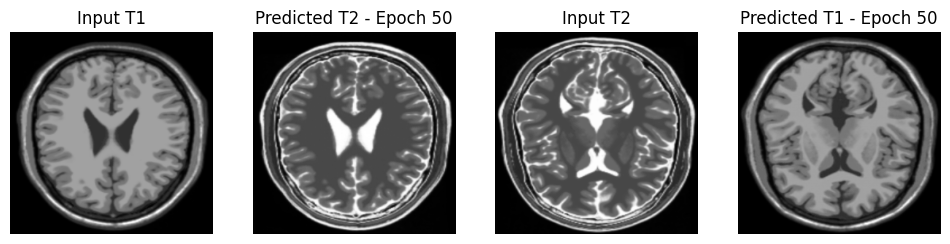

Checkpoint restored for epoch 50 at ../models/training_checkpoints/ckpt-15
Time taken in 28 seconds for epoch 50



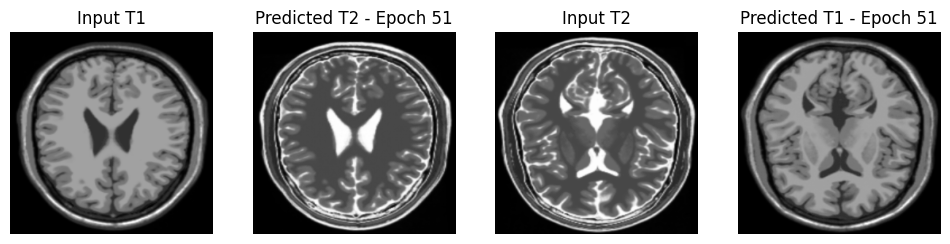

Time taken in 23 seconds for epoch 51



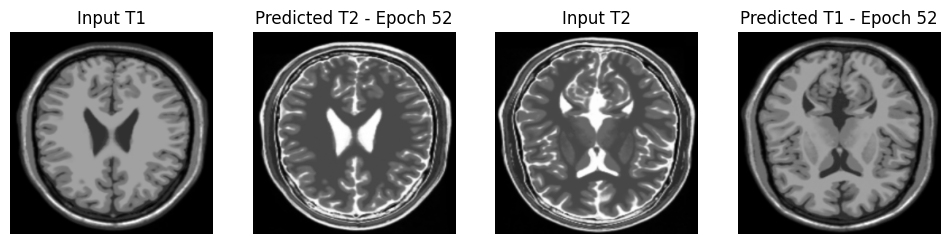

Time taken in 23 seconds for epoch 52



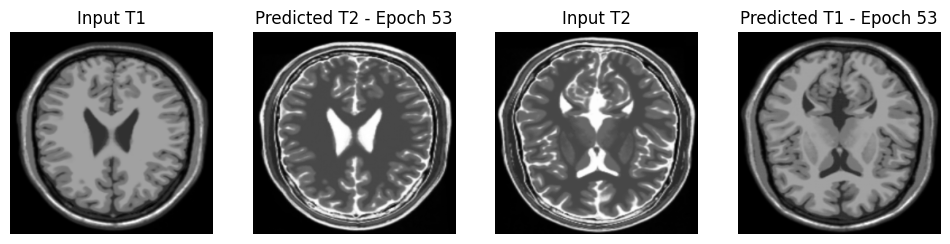

Time taken in 23 seconds for epoch 53



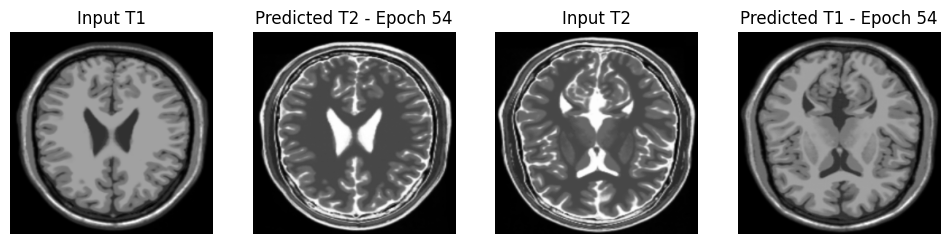

Time taken in 23 seconds for epoch 54



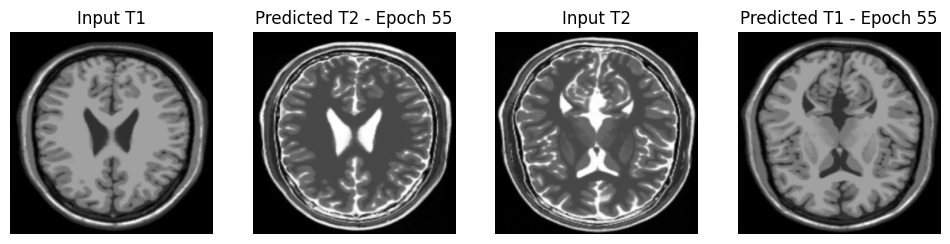

Time taken in 22 seconds for epoch 55



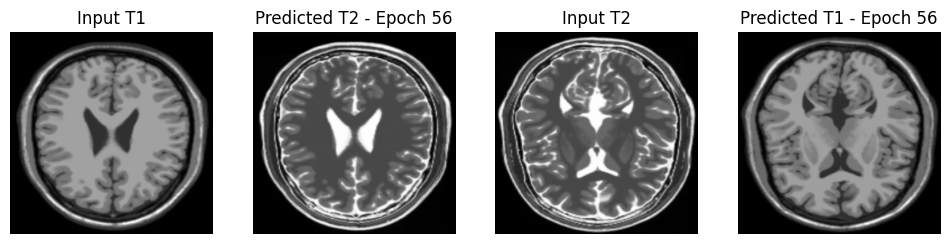

Time taken in 22 seconds for epoch 56



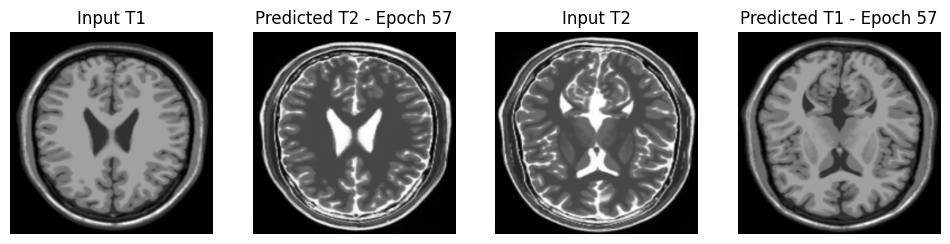

Time taken in 22 seconds for epoch 57



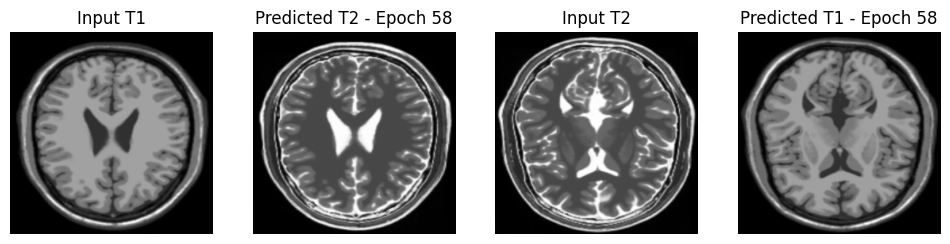

Time taken in 23 seconds for epoch 58



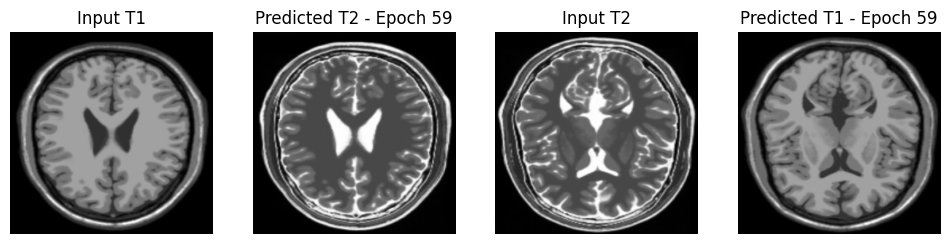

Time taken in 22 seconds for epoch 59



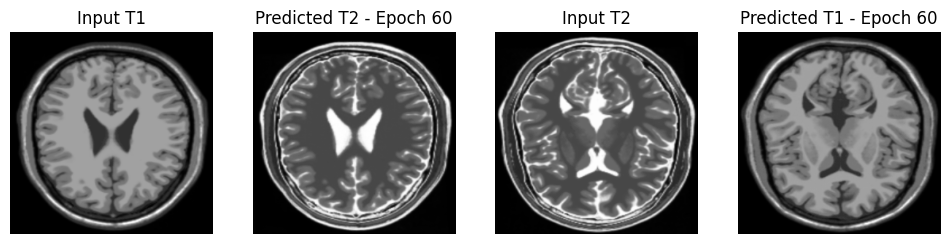

Checkpoint restored for epoch 60 at ../models/training_checkpoints/ckpt-16
Time taken in 28 seconds for epoch 60



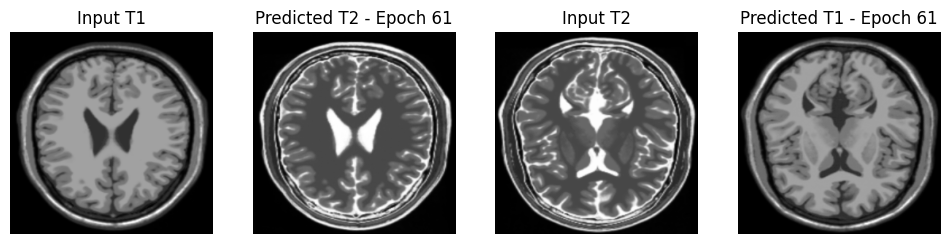

Time taken in 22 seconds for epoch 61



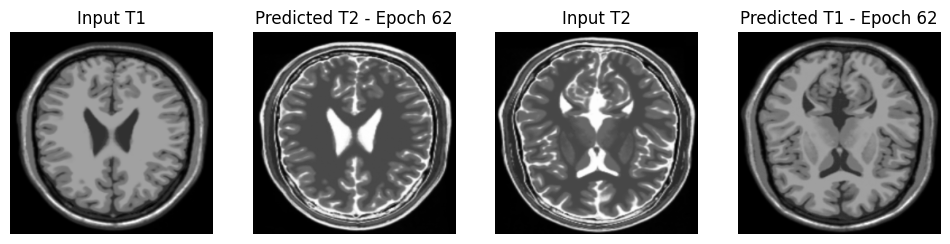

Time taken in 23 seconds for epoch 62



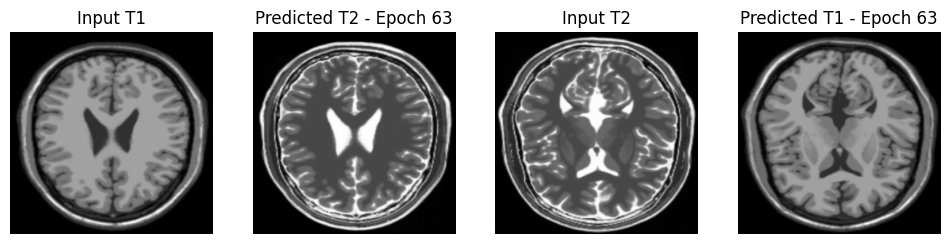

Time taken in 23 seconds for epoch 63



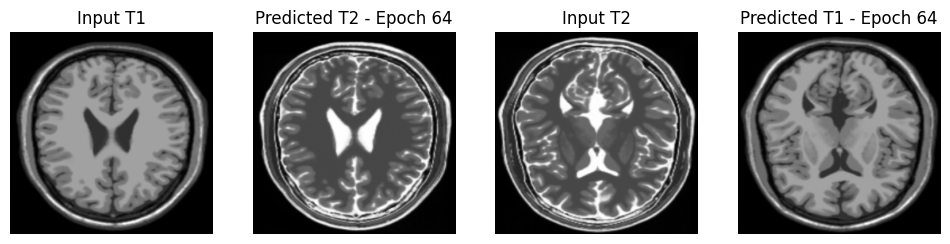

Time taken in 22 seconds for epoch 64



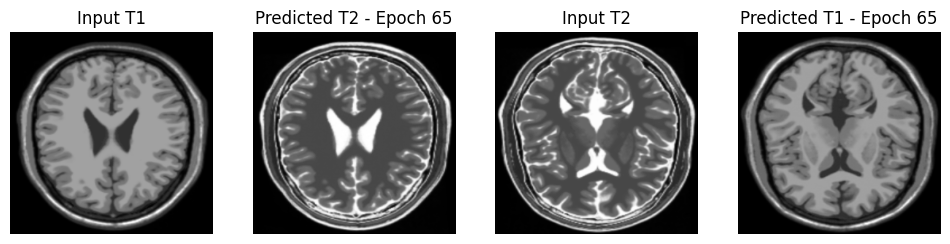

Time taken in 23 seconds for epoch 65



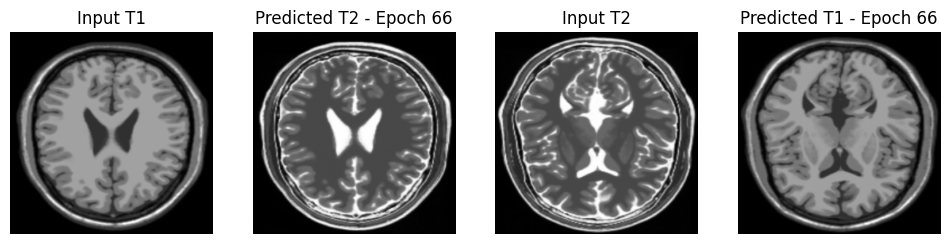

Time taken in 22 seconds for epoch 66



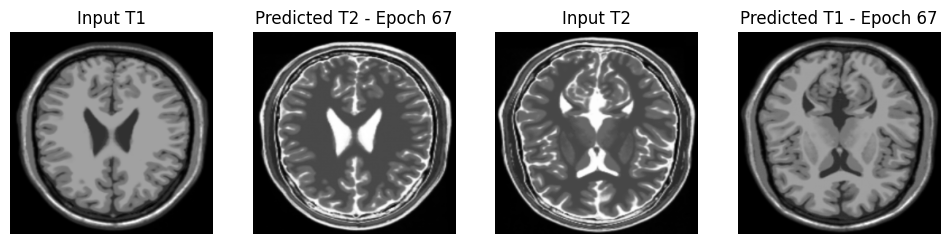

Time taken in 23 seconds for epoch 67



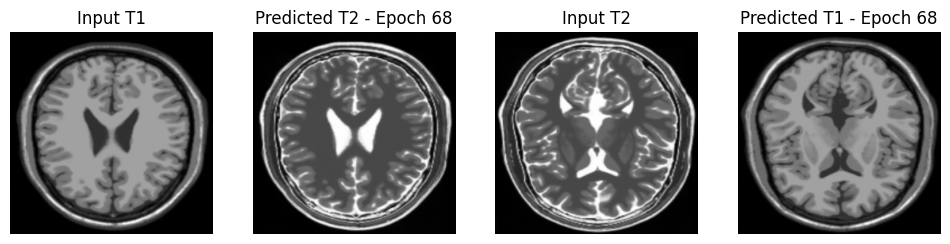

Time taken in 23 seconds for epoch 68



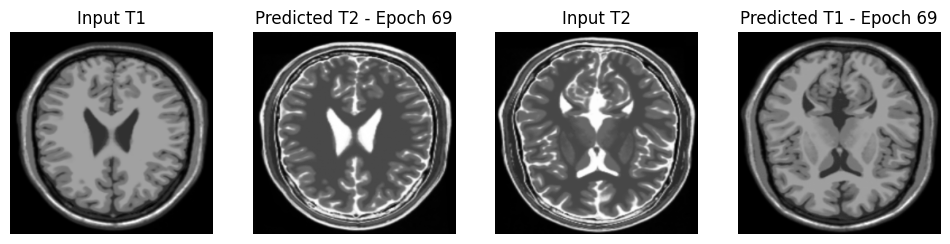

Time taken in 23 seconds for epoch 69



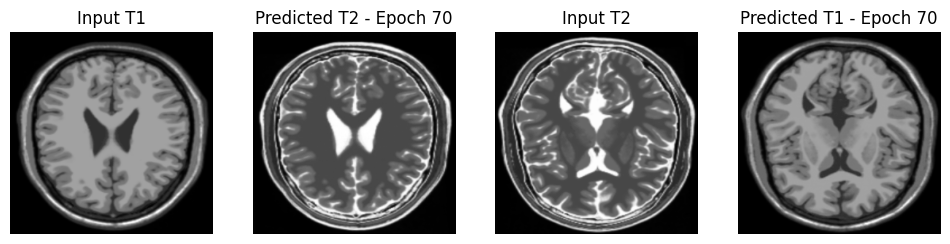

Checkpoint restored for epoch 70 at ../models/training_checkpoints/ckpt-17
Time taken in 75 seconds for epoch 70



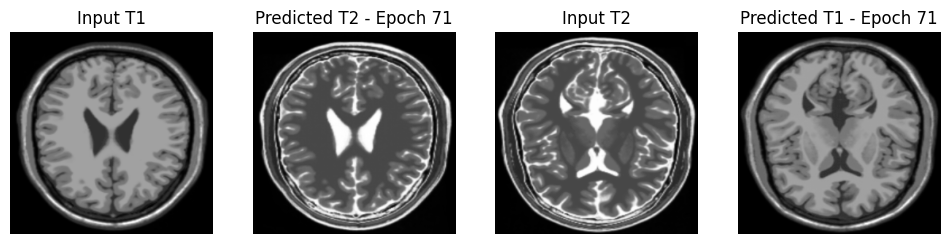

Time taken in 23 seconds for epoch 71



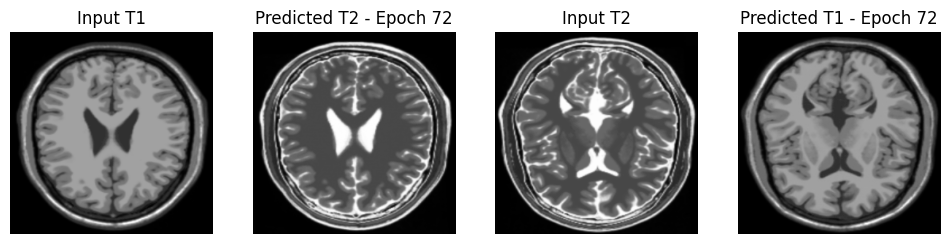

Time taken in 18 seconds for epoch 72



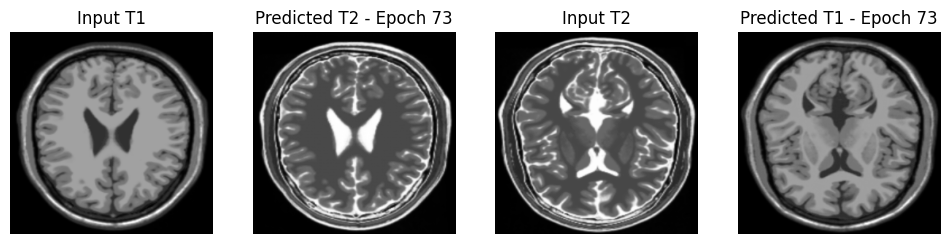

Time taken in 18 seconds for epoch 73



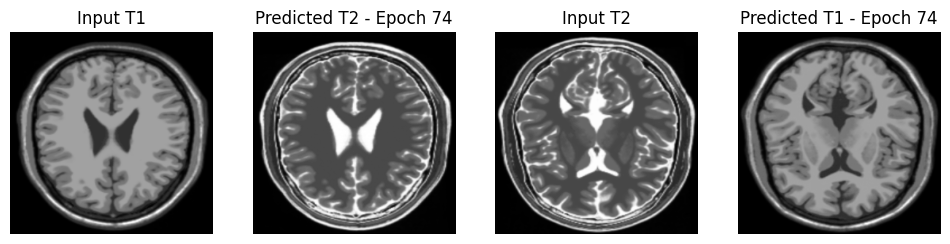

Time taken in 18 seconds for epoch 74



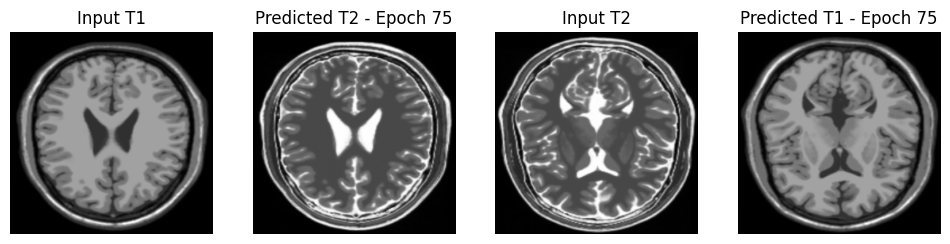

Time taken in 18 seconds for epoch 75



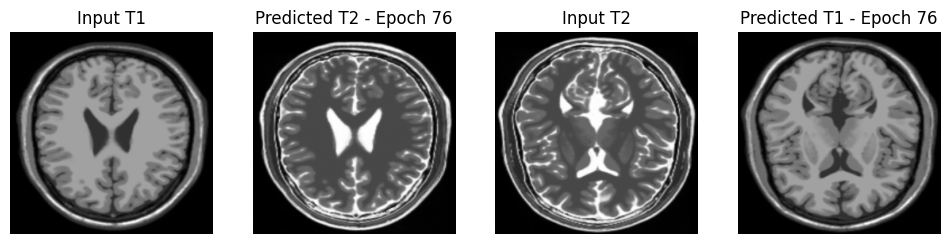

Time taken in 18 seconds for epoch 76



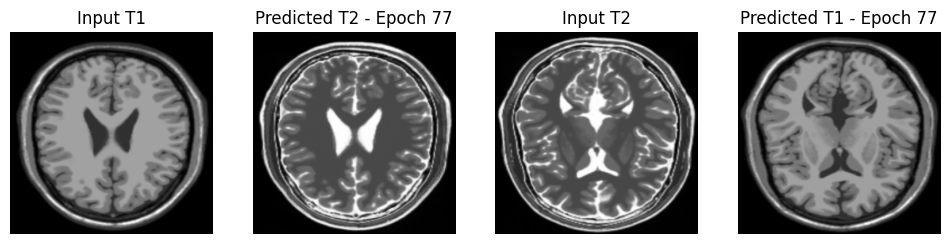

Time taken in 18 seconds for epoch 77



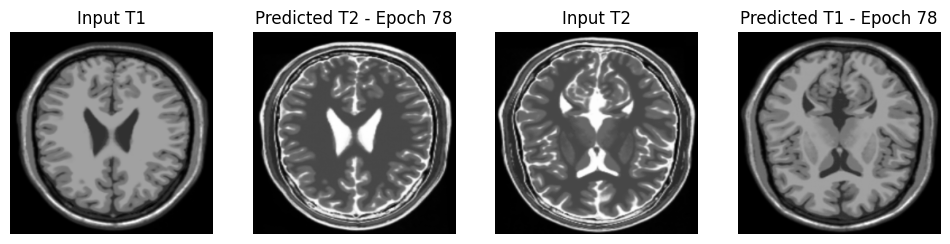

Time taken in 18 seconds for epoch 78



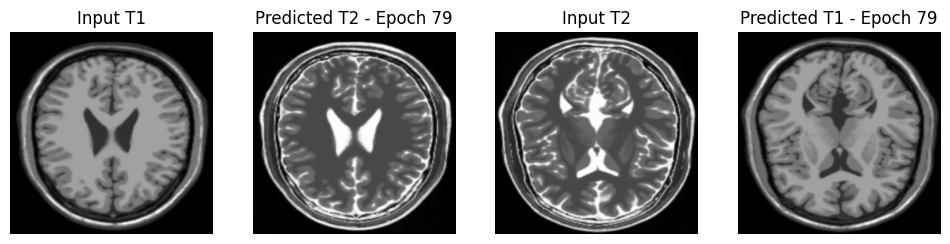

Time taken in 18 seconds for epoch 79



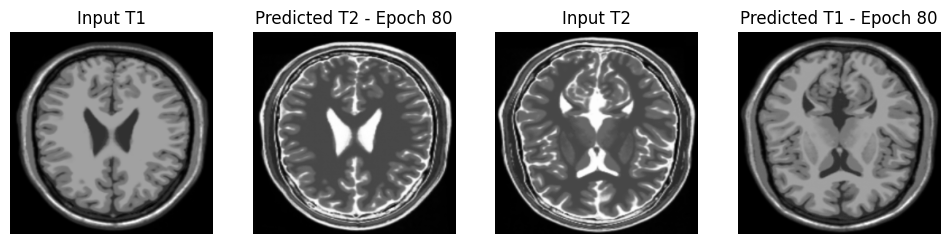

Checkpoint restored for epoch 80 at ../models/training_checkpoints/ckpt-18
Time taken in 22 seconds for epoch 80



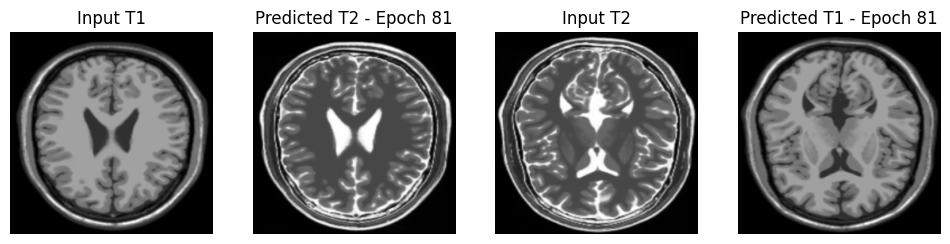

Time taken in 18 seconds for epoch 81



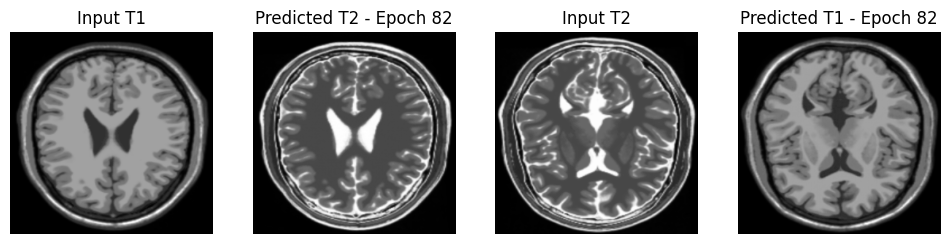

Time taken in 18 seconds for epoch 82



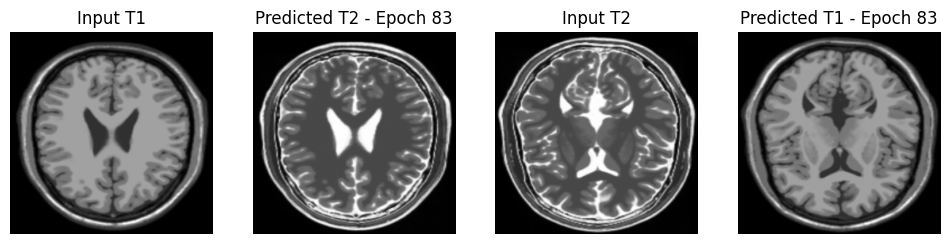

Time taken in 18 seconds for epoch 83



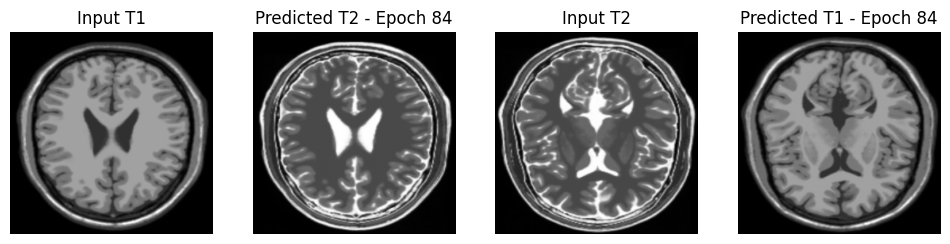

Time taken in 18 seconds for epoch 84



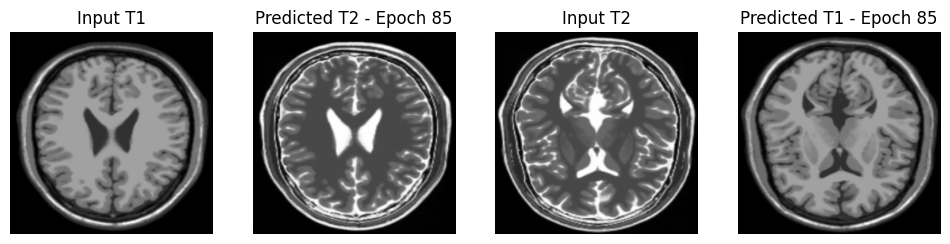

Time taken in 18 seconds for epoch 85



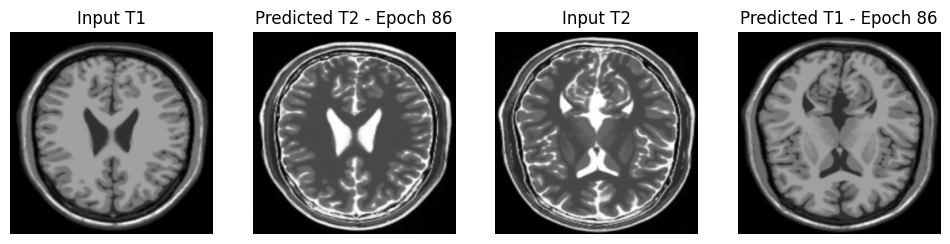

Time taken in 18 seconds for epoch 86



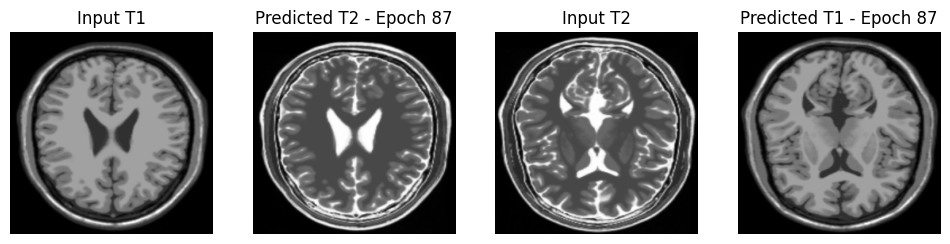

Time taken in 18 seconds for epoch 87



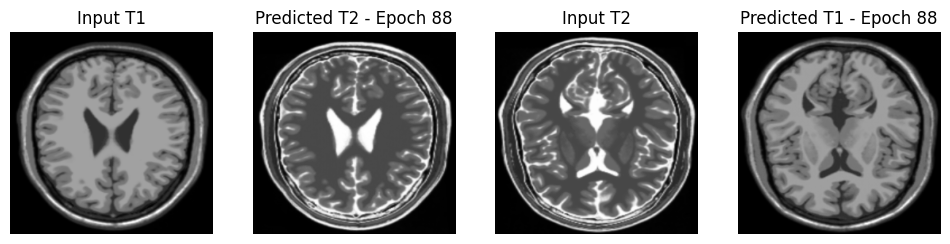

Time taken in 18 seconds for epoch 88



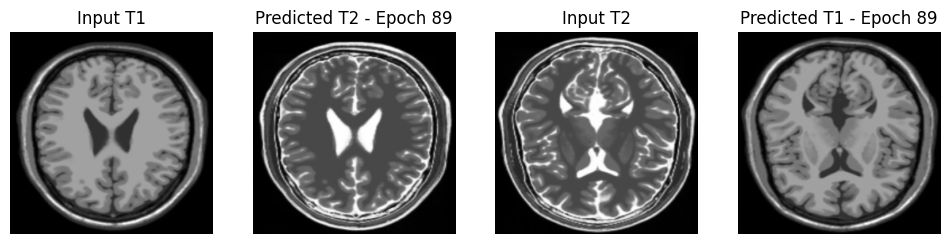

Time taken in 18 seconds for epoch 89



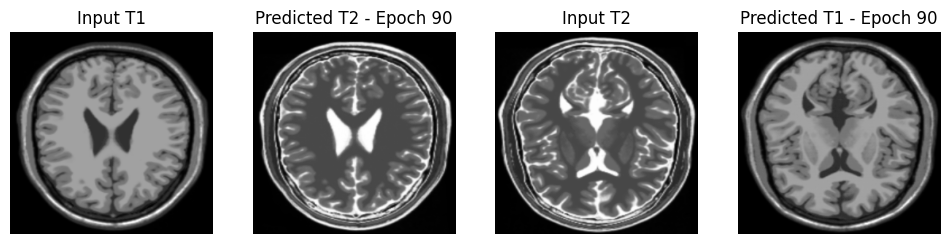

Checkpoint restored for epoch 90 at ../models/training_checkpoints/ckpt-19
Time taken in 21 seconds for epoch 90



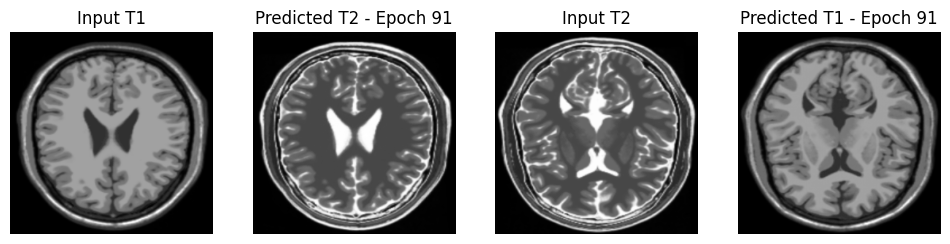

Time taken in 18 seconds for epoch 91



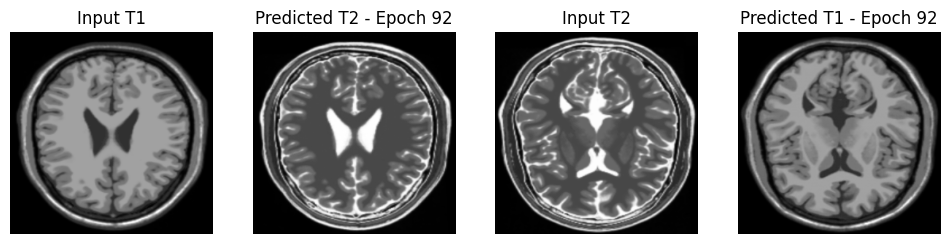

Time taken in 18 seconds for epoch 92



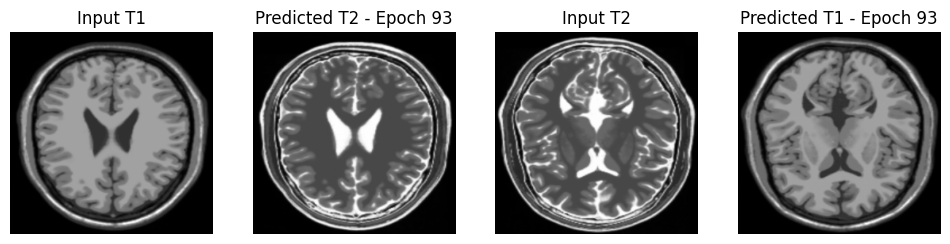

Time taken in 18 seconds for epoch 93



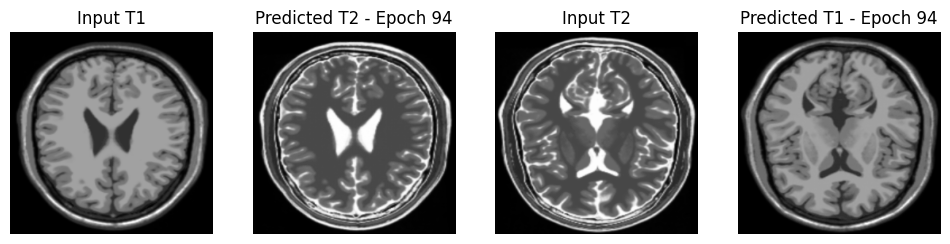

Time taken in 18 seconds for epoch 94



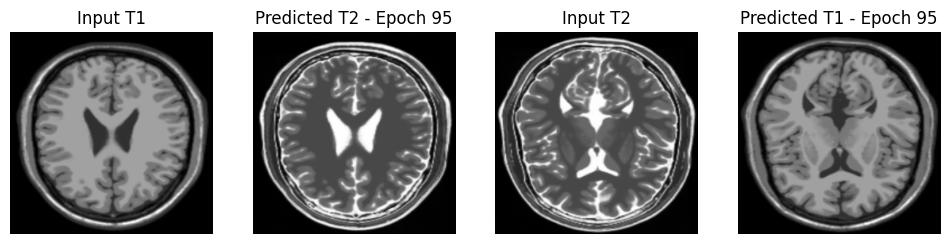

Time taken in 18 seconds for epoch 95



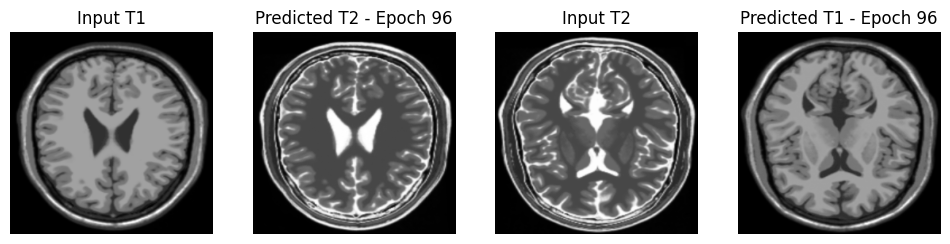

Time taken in 18 seconds for epoch 96



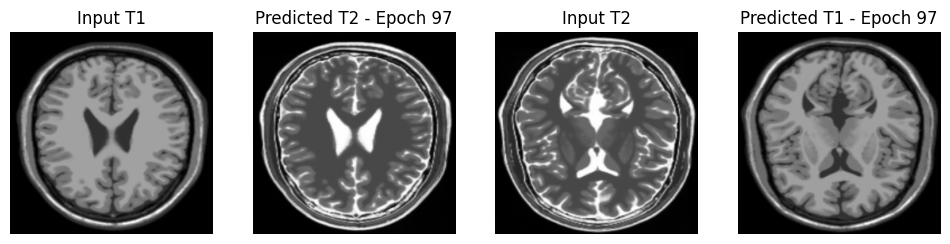

Time taken in 18 seconds for epoch 97



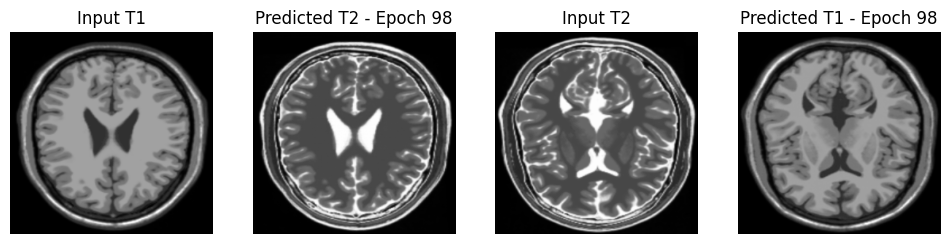

Time taken in 18 seconds for epoch 98



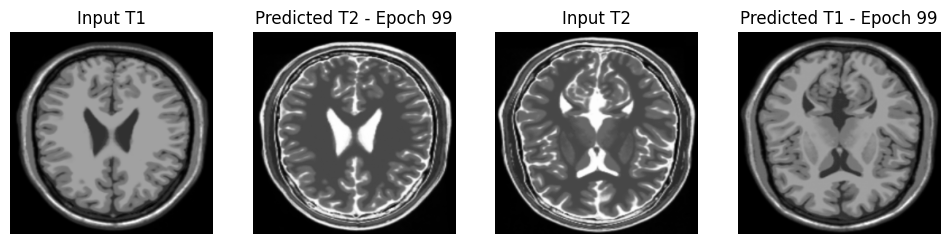

Time taken in 18 seconds for epoch 99



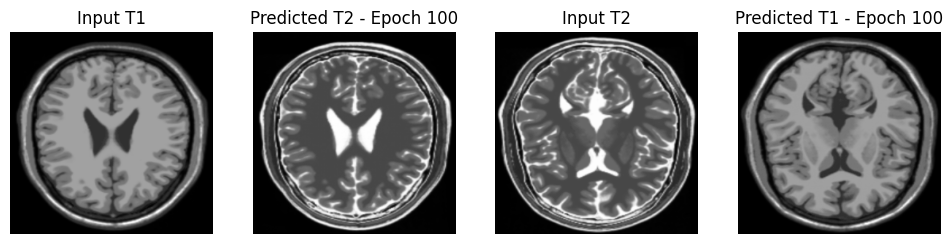

Checkpoint restored for epoch 100 at ../models/training_checkpoints/ckpt-20
trained models saved at 000100
Time taken in 23 seconds for epoch 100



In [39]:
# training the model
for epoch in range(EPOCHS):
    start = time.time() 
    for image_x, image_y in tf.data.Dataset.zip((T1, T2)): # preprocessed input
        train_step(image_x, image_y)
    if (epoch + 1) % 1 == 0:
        generate_images(generator_g, sample_T1, generator_f, sample_T2) # generates input and syntetic images
    if (epoch + 1) % 10 == 0:
        checkpoint_save_path = checkpoint_manager.save() # checkpoint saved for every 10 epochs in the given path
        print('Checkpoint restored for epoch {} at {}'.format(epoch+1, checkpoint_save_path))
    if (epoch + 1) == EPOCHS:
        final_model_save(epoch, generator_g, generator_f) # the last model is saved n the given path for further use
    print('Time taken in {} seconds for epoch {}\n'.format(round(time.time()-start),epoch + 1))

#### **Result:**   
After 100 epochs, the results are pretty good. The predicted images have a good likeness to their respective input image in terms of content, while having the style of the other image type.

- Predicted T2 has the features of input T1 in the style of T2.
- Predicted T1 has the features of input T2 in the style of T1.

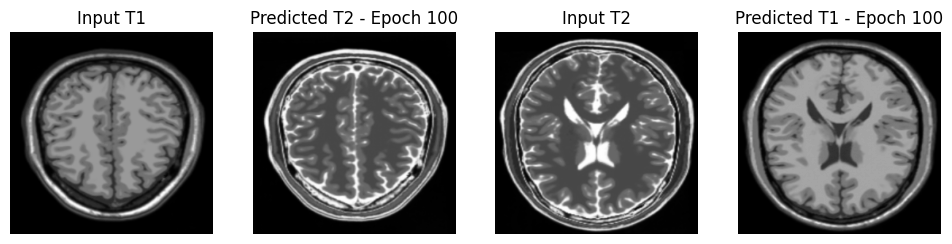

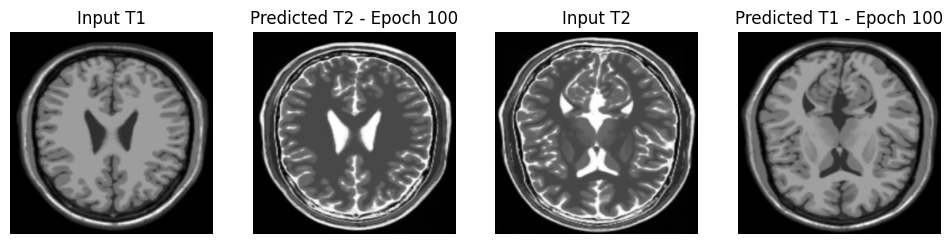

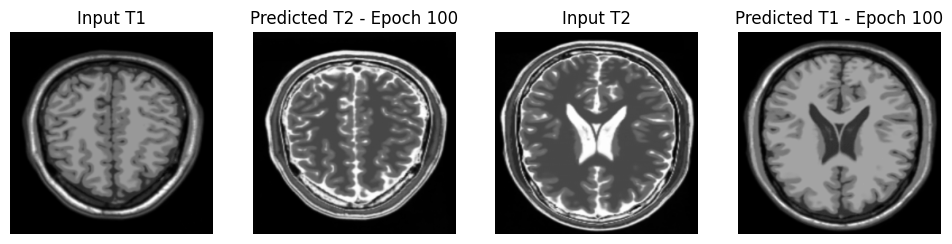

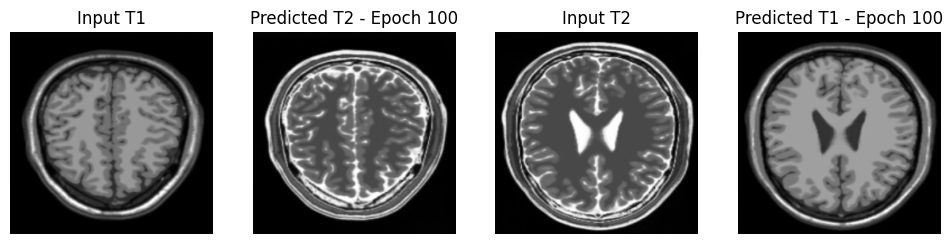

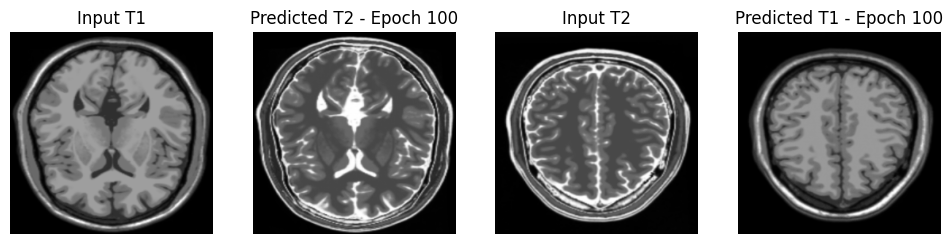

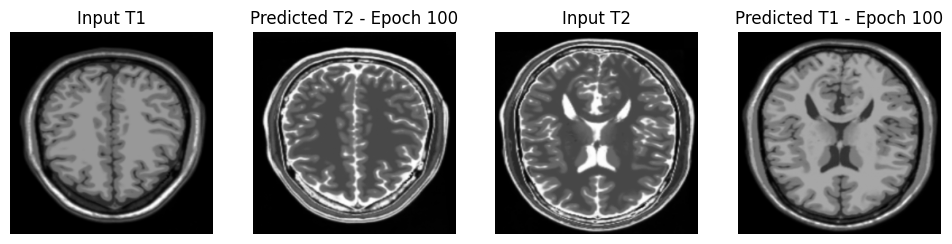

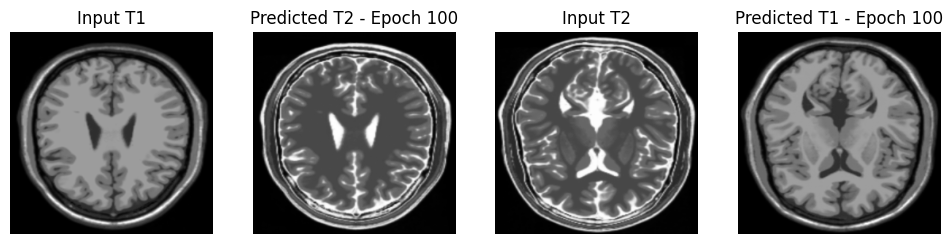

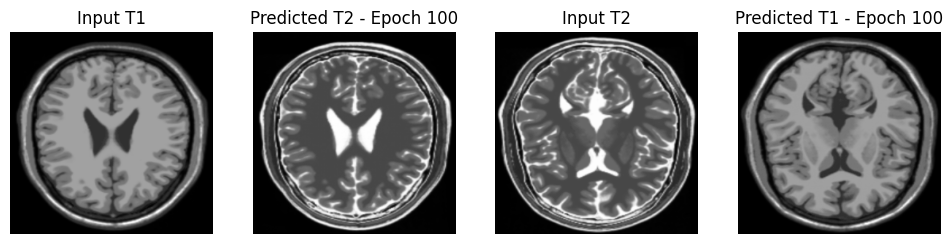

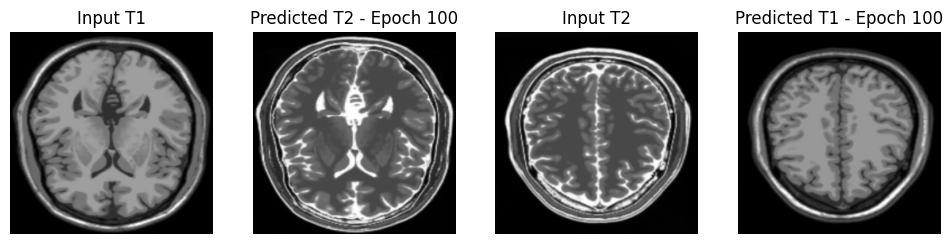

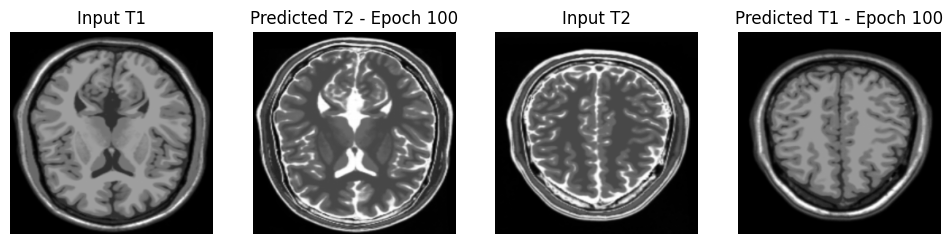

In [40]:
# check the trained model on different images and check the output
import itertools
for (T1,T2) in itertools.zip_longest(T1.take(10), T2.take(10)):
    generate_images(generator_g, T1, generator_f, T2)

## **Testing the Final Model**

In [41]:
# view synthetic images 
def compare_images(model_1, model_2, input):
    synthetic_image = model_1(input)
    reconstructed_image = model_2(synthetic_image)
    img_array = [input[0], synthetic_image[0], reconstructed_image[0]]
    img_title = ['Input Image', 'Synthetic Image', 'Reconstructed(cycled) Image']
    plt.figure(figsize=(12,9))
    for i in range(3):
        plt.subplot(1, 3, i+1)
        plt.title(img_title[i])
        plt.imshow(img_array[i].numpy()[:, :, 0], cmap='gray')
    plt.show()

In [42]:
from keras.models import load_model

custom_object = {'InstanceNormalization': InstanceNormalization} # custom_objects argument

# load models
model_1 = load_model('../models/model_save/T1_to_T2_final_model.h5', custom_object)
model_2 = load_model('../models/model_save/T2_to_T1_final_model.h5', custom_object)

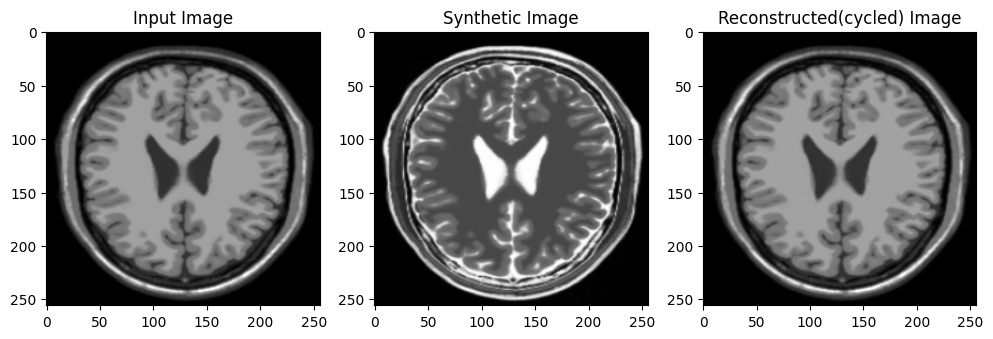

In [43]:
# T1->T2->T1
compare_images(model_1, model_2, sample_T1)

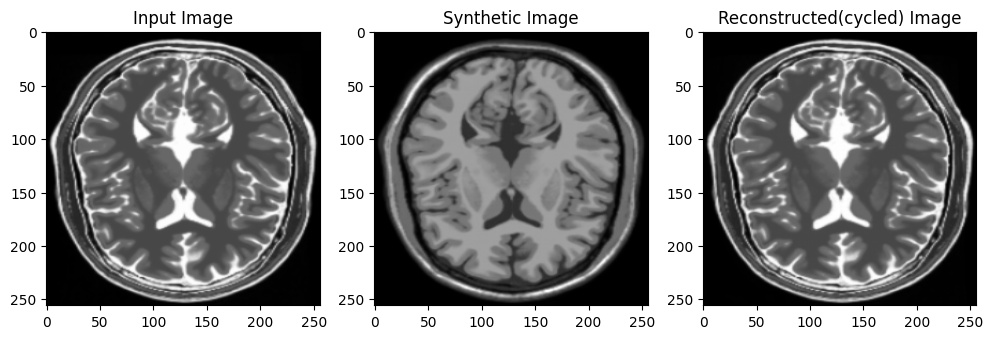

In [44]:
# T2->T1->T2
compare_images(model_2, model_1, sample_T2)

**Conclusion:**  Through visual inspection, we can confirm that the reconstructed image is similar to the input image

### **Generating a GIF for visualization of Results**

In [45]:
# Finally creating an animation to see how the style transfer happened across all epochs for both T1 and T2

anim_file = '../reports/figures/animated_cycleGAN_%d_epochs.gif' % (EPOCHS) # animation image name (GIF format)

with imageio.get_writer(anim_file, mode='I') as writer:
    filenames = glob.glob('../reports/chkpt_images/image*.png')
    filenames = sorted(filenames)
    for filename in filenames:
        image = imageio.imread(filename)
        writer.append_data(image)
    image = imageio.imread(filename)
    writer.append_data(image)

<img src="../reports/figures/animated_cycleGAN_100_epochs.gif" />

### **Conclusion**   
- We can see that a Cycle GAN architecture is effective in translating the style of T1 weighted MRI images to T2 weighted MRI image inputs, and vice versa.
- This can be very useful in more effective diagnosis, without the need of a second MRI scan. This not only saves time for the doctors, but would also reduce the financial burden on the patients.